### Tutorial in hamiltorch for log probabilities

* For the corresponding blog post please see: https://adamcobb.github.io/journal/hamiltorch.html
* Bayesian neural networks are left to a different notebook 

In [3]:
import torch
import hamiltorch
from hamiltorch.samplers import Metric, approximate_leapfrog_hmc
import matplotlib.pyplot as plt
from hamiltorch.plot_utils import plot_results

%matplotlib inline

In [4]:
hamiltorch.set_random_seed(123)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [5]:
print(hamiltorch.__version__)

0.4.1


In [6]:
print(device)

cpu


## Sampling a multivariate Gaussian

In `hamiltorch`, we have designed the samplers to receive a function handle `log_prob_func`, which the sampler will use to evaluate the log probability of each sample. A `log_prob_func` must take a 1-d vector of length equal to the number of parameters that are being sampled. For the example of our multivariate Gaussian distribution, we can define our `log_prob_func` as follows:

In [7]:
def log_prob(omega):
    mean = torch.tensor([0.,0.,0.])
    stddev = torch.tensor([.5,1.,2.]) 
    return torch.distributions.MultivariateNormal(mean, torch.diag(stddev**2)).log_prob(omega).sum()

In [8]:
N = 2000
step_size = .3
L = 5

### Sample using standard HMC
* Initialise the parameters e.g. `params_init = torch.zeros(3)` and pass them into the `hamiltorch.sample()` function as `params_init=params_init`.
* Set the number of samples `num_samples=N` corresponding to the number of momentum resampling steps/the number of trajectories to sample.
* Set the step size and trajectory length via `step_size=step_size, num_steps_per_sample=L`.

In [9]:
# HMC
hamiltorch.set_random_seed(123)
params_init = torch.zeros(3)
params_hmc = hamiltorch.sample(log_prob_func=log_prob, params_init=params_init, num_samples=N,
                               step_size=step_size, num_steps_per_sample=L, burn = 1000)

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec


KeyboardInterrupt: 

### Sample using the No-U-Turn Sampler (NUTS)
* As in Hoffman and Gelman 2011.
* This is set using the additional parameter `sampler=hamiltorch.Sampler.HMC_NUTS`.
* The step size is adapted with the objective of a desired acceptance rate `desired_accept_rate=0.8`.
* The step size is fixed after the burn stage `burn=burn` and we define `N_nuts = burn + N`


In [ ]:
# HMC NUTS
hamiltorch.set_random_seed(123)
params_init = torch.zeros(3) + 5
burn=1000
N_nuts = N
params_hmc_nuts = hamiltorch.sample(log_prob_func=log_prob, params_init=params_init,
                                                  num_samples=N_nuts,step_size=step_size,num_steps_per_sample=L,
                                                  sampler=hamiltorch.Sampler.HMC_NUTS, burn=burn,
                                                  desired_accept_rate=0.8,)

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Final Adapted Step Size:  0.6864785552024841---- |  971/2000 | 241.03       
0d:00:00:08 | 0d:00:00:00 | #################### | 2000/2000 | 241.78       
Acceptance Rate 0.81


### Sample using the Surrogate HMC Sampler
* As in https://andrewjholbrook.github.io/papers/Li.pdf


In [ ]:
# HMC NUTS
hamiltorch.set_random_seed(123)
params_init = torch.zeros(3)
burn=1000
N_surrogate = N
params_hmc_surrogate, surrogate_model = hamiltorch.sample_surrogate_hmc(log_prob_func=log_prob, params_init=params_init,
                                                  num_samples=N_surrogate,step_size=step_size,num_steps_per_sample=L,burn=burn,
                                                  desired_accept_rate=0.8)

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Training Surrogate Model4 | ##########---------- |  957/2000 | 237.64       
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:00:03 | 0d:00:00:00 | #################### | 1000/1000 | 266.56       
Acceptance Rate 0.98


### Sample using the Surrogate HMC Sampler With Neural Dynamics (Explicit hamiltonian )
* We replace the Hamiltonian and integrator with the Neural ODE

In [ ]:
hamiltorch.set_random_seed(123)
params_init = torch.zeros(3)
burn=1000
N_surrogate_ode = N
params_hmc_surrogate_ode_explicit, surrogate_model_ode_explicit = hamiltorch.sample_neural_ode_surrogate_hmc(log_prob_func=log_prob, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn, model_type = "explicit_hamiltonian"
                                                  )

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model
0d:00:00:10 | 0d:00:00:00 | #################### | 2000/2000 | 195.69       
Acceptance Rate 0.70


### Sample using the Surrogate HMC Sampler With Neural Dynamics (Gradient Only)
* We replace the integrator with the Neural ODE

In [ ]:
hamiltorch.set_random_seed(123)
params_init = torch.zeros(3)
burn=1000
N_surrogate_ode = N
params_hmc_surrogate_ode_nnghmc, surrogate_model_ode_nnghmc = hamiltorch.sample_neural_ode_surrogate_hmc(log_prob_func=log_prob, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn, model_type = ""
                                                  )

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model
0d:00:00:07 | 0d:00:00:00 | #################### | 2000/2000 | 269.40       
Acceptance Rate 0.92


### Sample using implicit Riemannian manifold Hamiltonian Monte Carlo (RMHMC)

* As in Girolami and Calderhead 2011.
* Switch the sampler via setting `sampler=hamiltorch.Sampler.RMHMC` and the integrator via `integrator=hamiltorch.Integrator.IMPLICIT`.
* Limit the number of fixed point iterations in the generalised leapforg via `fixed_point_max_iterations=1000` and set the convergence threshold for 'breaking out' of the while loop via `fixed_point_threshold=1e-05`.


In [ ]:
# Implicit RMHMC
hamiltorch.set_random_seed(123)
params_init = torch.zeros(3)
params_irmhmc = hamiltorch.sample(log_prob_func=log_prob, params_init=params_init, num_samples=N,
                                  step_size=step_size,num_steps_per_sample=L, sampler=hamiltorch.Sampler.RMHMC,
                                  integrator=hamiltorch.Integrator.IMPLICIT, fixed_point_max_iterations=1000,
                                  fixed_point_threshold=1e-05)

Sampling (Sampler.RMHMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:02:51 | 0d:00:00:00 | #################### | 2000/2000 | 11.67       
Acceptance Rate 0.99


### Sample using explicit Riemannian manifold Hamiltonian Monte Carlo (RMHMC)

* As in Cobb et. al. 2019
* Switch the integrator to explicit via `integrator=hamiltorch.Integrator.EXPLICIT`. Note that the sampler is still set to RMHMC.
* Introduce and set the binding term via `explicit_binding_const=omega`. This can be subsequently optimised for the highest acceptance rate.



In [ ]:
# Explicit RMHMC
hamiltorch.set_random_seed(123)
params_init = torch.zeros(3)
omega = 100.
params_ermhmc = hamiltorch.sample(log_prob_func=log_prob, params_init=params_init, num_samples=N,
                                  step_size=step_size,num_steps_per_sample=L, sampler=hamiltorch.Sampler.RMHMC,
                                  integrator=hamiltorch.Integrator.EXPLICIT, explicit_binding_const=omega, burn=burn)

Sampling (Sampler.RMHMC; Integrator.EXPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:03:43 | 0d:00:00:00 | #################### | 2000/2000 | 8.95        
Acceptance Rate 0.98


### Sample using the Surrogate RMHMC Sampler With Neural Dynamics (Gradient Only )
* We replace the integrator with the Neural ODE

In [ ]:
hamiltorch.set_random_seed(123)
params_init = torch.zeros(3)

N_surrogate_ode = N
params_surrogate_ode_nngrmhmc, surrogate_model_ode_nngrmhmc = hamiltorch.sample_neural_ode_surrogate_rmhmc(log_prob_func=log_prob, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn,model_type = ""
                                                  )

Sampling (Sampler.RMHMC; Integrator.EXPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model
0d:00:02:55 | 0d:00:00:00 | #################### | 2000/2000 | 11.39       
Acceptance Rate 0.96


### Sample using the Surrogate RMHMC Sampler With Neural Dynamics (Explicit Hamiltonian )
* We replace the integrator with the Neural ODE

In [ ]:
hamiltorch.set_random_seed(123)
params_init = torch.zeros(3)
burn = 1000
N_surrogate_ode = N
params_rmhmc_surrogate_ode_explicit, surrogate_model_ode_rmhmc_explicit = hamiltorch.sample_neural_ode_surrogate_rmhmc(log_prob_func=log_prob, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn,model_type = "explicit_hamiltonian"
                                                  )

Sampling (Sampler.RMHMC; Integrator.EXPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model


RuntimeError: The size of tensor a (2) must match the size of tensor b (6) at non-singleton dimension 1

## Test Reversibility
Ideally ODESolve(f, ODESolve(f, ($q_0$, $p_0$), t), -t) should yield ($q_0$, $p_0$)

In [ ]:
hamiltorch.set_random_seed(1)
test_momentums = torch.distributions.MultivariateNormal(torch.zeros(3), torch.eye(3)).sample_n(100)
mean = torch.tensor([0.,0.,0.])
stddev = torch.tensor([.5,1.,2.]) 
test_positions = torch.distributions.MultivariateNormal(mean, torch.diag(stddev**2)).sample_n(100)
test_initial_conditions = torch.cat([test_positions, test_momentums], -1)
t = torch.linspace(start = 0, end = L*step_size, steps=L)

/home/abhijitbrahme/.conda/envs/approx-hmc/lib/python3.12/site-packages/torch/distributions/distribution.py:179: UserWarning: sample_n will be deprecated. Use .sample((n,)) instead
  warnings.warn(


## Test for Gradient Only Method

In [ ]:
with torch.no_grad():
    _, forward_trajectories = surrogate_model_ode_nnghmc.forward(test_initial_conditions, t)

forward_trajectories = torch.swapaxes(forward_trajectories, 0, 1)
end_positions = forward_trajectories[:,-1,:]
backward_conditions = torch.matmul(end_positions, torch.block_diag(torch.eye(3), -1*torch.eye(3)))
backward_t = torch.linspace(end = 0, start = L*step_size, steps=L)
with torch.no_grad():
    _, backward_trajectories = surrogate_model_ode_nnghmc.forward(backward_conditions ,  backward_t)
backward_trajectories = torch.swapaxes(backward_trajectories, 0, 1)

In [ ]:
torch.nn.MSELoss()(backward_trajectories[:, -1, :3], test_initial_conditions[..., :3])

tensor(8.8723)

## Test for Hamiltonian Explicit Method

In [ ]:
with torch.no_grad():
    _, forward_trajectories = surrogate_model_ode_explicit.forward(test_initial_conditions, t)

forward_trajectories = torch.swapaxes(forward_trajectories, 0, 1)
end_positions = forward_trajectories[:,-1,:]
backward_conditions = torch.matmul(end_positions, torch.block_diag(torch.eye(3), -1*torch.eye(3)))
backward_t = torch.linspace(end = 0, start = L*step_size, steps=L)
with torch.no_grad():
    _, backward_trajectories = surrogate_model_ode_explicit.forward(backward_conditions ,  backward_t)
backward_trajectories = torch.swapaxes(backward_trajectories, 0, 1)

In [ ]:
torch.nn.MSELoss()(backward_trajectories[:, -1, :3], test_initial_conditions[..., :3])

tensor(2.3971)

### Convert samples to numpy arrays to plot using matplotlib

In [ ]:
coords_hmc = torch.cat(params_hmc).reshape(len(params_hmc),-1).numpy()
coords_nuts = torch.cat(params_hmc_nuts).reshape(len(params_hmc_nuts),-1).numpy()
coords_surrogate_ode_nnghmc = torch.cat(params_hmc_surrogate_ode_nnghmc).reshape(len(params_hmc_surrogate_ode_nnghmc),-1).numpy()
coords_surrogate_ode_explicit = torch.cat(params_hmc_surrogate_ode_explicit).reshape(len(params_hmc_surrogate_ode_explicit),-1).numpy()
coords_surrogate = torch.cat(params_hmc_surrogate).reshape(len(params_hmc_surrogate),-1).numpy()
coords_surrogate_ode_explicit_rmhmc = torch.cat(params_rmhmc_surrogate_ode_explicit).reshape(len(params_rmhmc_surrogate_ode_explicit),-1).numpy()
coords_surrogate_ode_nngrmhmc = torch.cat(params_surrogate_ode_nngrmhmc).reshape(len(params_surrogate_ode_nngrmhmc),-1).numpy()
coords_i_rmhmc = torch.cat(params_irmhmc).reshape(len(params_irmhmc),-1).numpy()
coords_e_rmhmc = torch.cat(params_ermhmc).reshape(len(params_ermhmc),-1).numpy()

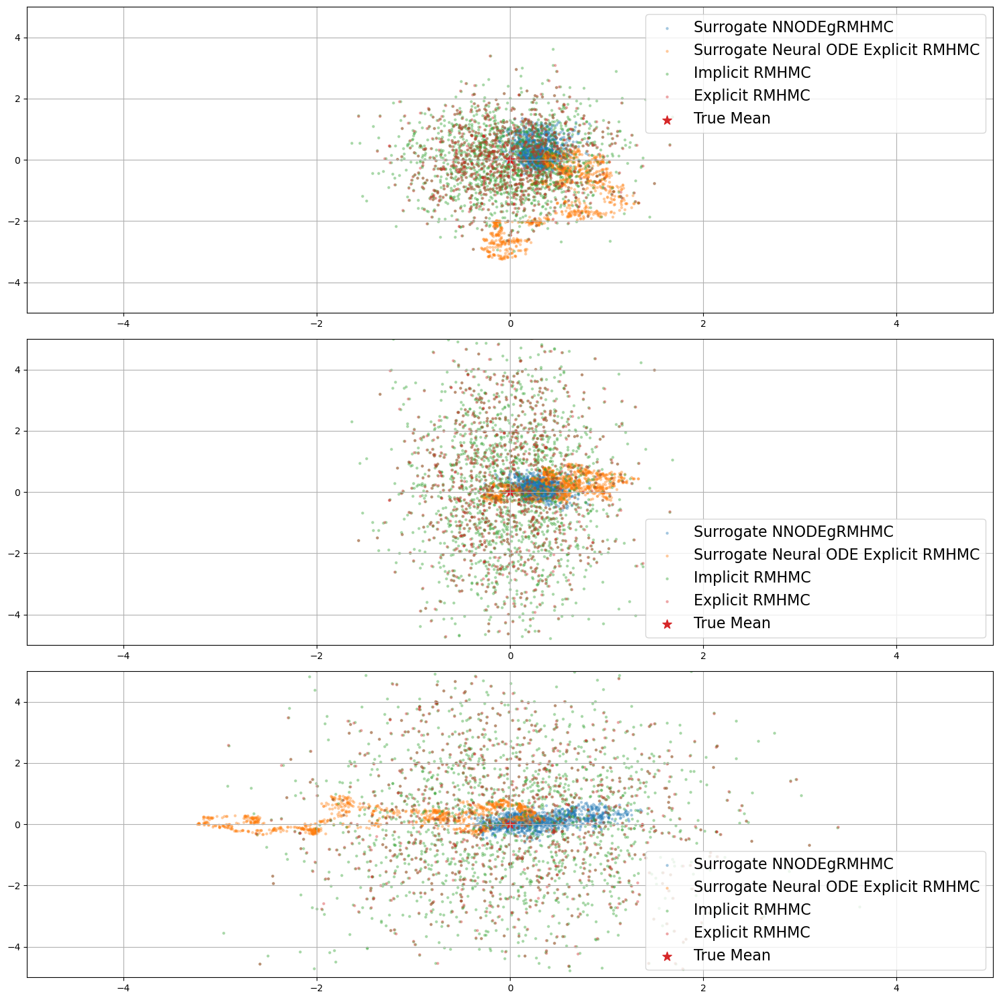

In [ ]:
xlim = [-5,5]
ylim = [-5,5]
fs=16
mean = torch.tensor([0.,0.,0.])
stddev = torch.tensor([.5,1.,2.])

fig, axs = plt.subplots(3, 1, figsize=(15,15))

# axs[0].scatter(coords_hmc[:,0], coords_hmc[:,1],s=5,alpha=0.3,label='HMC')
# axs[0].scatter(coords_nuts[:,0], coords_nuts[:,1],s=5,alpha=0.3,label='NUTS')
# axs[0].scatter(coords_surrogate[:,0], coords_surrogate[:,1],s=5,alpha=0.3,label='Surrogate HMC')
axs[0].scatter(coords_surrogate_ode_nngrmhmc[:,0], coords_surrogate_ode_nngrmhmc[:,1],s=5,alpha=0.3,label='Surrogate NNODEgRMHMC')
# axs[0].scatter(coords_surrogate_ode_nnghmc[:, 0], coords_surrogate_ode_nnghmc[:, 1], s = 5, alpha = .3, label = "Surrogate NNODEgHMC")
# axs[0].scatter(coords_surrogate_ode_explicit[:,0], coords_surrogate_ode_explicit[:,1],s=5,alpha=0.3,label='Surrogate Neural ODE Explicit')
axs[0].scatter(coords_surrogate_ode_explicit_rmhmc[:,0], coords_surrogate_ode_explicit_rmhmc[:,1],s=5,alpha=0.3,label='Surrogate Neural ODE Explicit RMHMC')
axs[0].scatter(coords_i_rmhmc[:,0], coords_i_rmhmc[:,1],s=5,alpha=0.3,label='Implicit RMHMC')
axs[0].scatter(coords_e_rmhmc[:,0], coords_e_rmhmc[:,1],s=5,alpha=0.3,label='Explicit RMHMC')

axs[0].scatter(mean[0],mean[1],marker = '*',color='C3',s=100,label='True Mean')
axs[0].legend(fontsize=fs)
axs[0].grid()
axs[0].set_xlim(xlim)
axs[0].set_ylim(ylim)

# axs[1].scatter(coords_hmc[:,0], coords_hmc[:,2],s=5,alpha=0.3,label='HMC')
# axs[1].scatter(coords_nuts[:,0], coords_nuts[:,2],s=5,alpha=0.3,label='NUTS')
# axs[1].scatter(coords_surrogate[:,0], coords_surrogate[:,2],s=5,alpha=0.3,label='Surrogate HMC')
axs[1].scatter(coords_surrogate_ode_nngrmhmc[:,0], coords_surrogate_ode_nngrmhmc[:,2],s=5,alpha=0.3,label='Surrogate NNODEgRMHMC')
# axs[1].scatter(coords_surrogate_ode_nnghmc[:, 0], coords_surrogate_ode_nnghmc[:, 2], s = 5, alpha = .3, label = "Surrogate NNODEgHMC")
# axs[1].scatter(coords_surrogate_ode_explicit[:,0], coords_surrogate_ode_explicit[:,2],s=5,alpha=0.3,label='Surrogate Neural ODE Explicit')
axs[1].scatter(coords_surrogate_ode_explicit_rmhmc[:,0], coords_surrogate_ode_explicit_rmhmc[:,2],s=5,alpha=0.3,label='Surrogate Neural ODE Explicit RMHMC')
axs[1].scatter(coords_i_rmhmc[:,0], coords_i_rmhmc[:,2],s=5,alpha=0.3,label='Implicit RMHMC')
axs[1].scatter(coords_e_rmhmc[:,0], coords_e_rmhmc[:,2],s=5,alpha=0.3,label='Explicit RMHMC')
axs[1].scatter(mean[0],mean[2],marker = '*',color='C3',s=100,label='True Mean')
axs[1].legend(fontsize=fs)
axs[1].grid()
axs[1].set_xlim(xlim)
axs[1].set_ylim(ylim)

# axs[2].scatter(coords_hmc[:,1], coords_hmc[:,2],s=5,alpha=0.3,label='HMC')
# axs[2].scatter(coords_nuts[:,1], coords_nuts[:,2],s=5,alpha=0.3,label='NUTS')
# axs[2].scatter(coords_surrogate[:,1], coords_surrogate[:,2],s=5,alpha=0.3,label='Surrogate HMC')
axs[2].scatter(coords_surrogate_ode_nngrmhmc[:,1], coords_surrogate_ode_nngrmhmc[:,2],s=5,alpha=0.3,label='Surrogate NNODEgRMHMC')
# axs[2].scatter(coords_surrogate_ode_nnghmc[:,1], coords_surrogate_ode_nnghmc[:,2],s=5,alpha=0.3,label='Surrogate Neural NNODEgHMC')
# axs[2].scatter(coords_surrogate_ode_explicit[:,1], coords_surrogate_ode_explicit[:,2],s=5,alpha=0.3,label='Surrogate Neural ODE Explicit')
axs[2].scatter(coords_surrogate_ode_explicit_rmhmc[:,1], coords_surrogate_ode_explicit_rmhmc[:,2],s=5,alpha=0.3,label='Surrogate Neural ODE Explicit RMHMC')

axs[2].scatter(coords_i_rmhmc[:,1], coords_i_rmhmc[:,2],s=5,alpha=0.3,label='Implicit RMHMC')
axs[2].scatter(coords_e_rmhmc[:,1], coords_e_rmhmc[:,2],s=5,alpha=0.3,label='Explicit RMHMC')
axs[2].scatter(mean[1],mean[2],marker = '*',color='C3',s=100,label='True Mean')
axs[2].legend(fontsize=fs)
axs[2].grid()
axs[2].set_xlim(xlim)
axs[2].set_ylim(ylim)

plt.tight_layout()

# plt.savefig('../../Gaussian_plots.png',bbox_inches='tight')
plt.show()

### KL divergence:
* Calculated the KL divergence as a measure of how well we have approximated the target distribution (the Gaussian).

In [ ]:
p = torch.distributions.MultivariateNormal(mean, stddev.diag()**2)
q_hmc = torch.distributions.MultivariateNormal(torch.FloatTensor(coords_hmc.mean(0)),torch.diag(torch.FloatTensor(coords_hmc.var(0))))
q_nuts = torch.distributions.MultivariateNormal(torch.FloatTensor(coords_nuts.mean(0)),torch.diag(torch.FloatTensor(coords_nuts.var(0))))
q_surrogate = torch.distributions.MultivariateNormal(torch.FloatTensor(coords_surrogate.mean(0)),torch.diag(torch.FloatTensor(coords_surrogate.var(0))))
q_surrogate_ode_nngrmhmc = torch.distributions.MultivariateNormal(torch.FloatTensor(coords_surrogate_ode_nngrmhmc.mean(0)),torch.diag(torch.FloatTensor(coords_surrogate_ode_nngrmhmc.var(0))))
q_surrogate_ode_explicit = torch.distributions.MultivariateNormal(torch.FloatTensor(coords_surrogate_ode_explicit.mean(0)),torch.diag(torch.FloatTensor(coords_surrogate_ode_explicit.var(0))))
q_surrogate_ode_explicit_rmhmc = torch.distributions.MultivariateNormal(torch.FloatTensor(coords_surrogate_ode_explicit_rmhmc.mean(0)),torch.diag(torch.FloatTensor(coords_surrogate_ode_explicit_rmhmc.var(0))))
q_surrogate_ode_nnghmc = torch.distributions.MultivariateNormal(torch.FloatTensor(coords_surrogate_ode_nnghmc.mean(0)),torch.diag(torch.FloatTensor(coords_surrogate_ode_nnghmc.var(0))))
q_i_rmhmc = torch.distributions.MultivariateNormal(torch.FloatTensor(coords_i_rmhmc.mean(0)),torch.diag(torch.FloatTensor(coords_i_rmhmc.var(0))))
q_e_rmhmc = torch.distributions.MultivariateNormal(torch.FloatTensor(coords_e_rmhmc.mean(0)),torch.diag(torch.FloatTensor(coords_e_rmhmc.var(0))))

print('HMC kl:            ',torch.distributions.kl.kl_divergence(p, q_hmc))
print('NUTS kl:           ',torch.distributions.kl.kl_divergence(p, q_nuts))
print('Implicit RMHMC kl: ',torch.distributions.kl.kl_divergence(p, q_i_rmhmc))
print('Explicit RMHMC kl: ',torch.distributions.kl.kl_divergence(p, q_e_rmhmc))
print('Surrogate kl: ',torch.distributions.kl.kl_divergence(p, q_surrogate))
print('Surrogate ODE NNgRMHMC kl: ',torch.distributions.kl.kl_divergence(p, q_surrogate_ode_nngrmhmc))
print('Surrogate ODE Explicit kl: ',torch.distributions.kl.kl_divergence(p, q_surrogate_ode_explicit))
print('Surrogate ODE Explicit RMHMC kl: ',torch.distributions.kl.kl_divergence(p, q_surrogate_ode_explicit_rmhmc))
print("Surrogate ODE NNgHMC kl", torch.distributions.kl.kl_divergence(p, q_surrogate_ode_nnghmc))



ValueError: Expected parameter covariance_matrix (Tensor of shape (2, 2)) of distribution MultivariateNormal(loc: torch.Size([2]), covariance_matrix: torch.Size([2, 2])) to satisfy the constraint PositiveDefinite(), but found invalid values:
tensor([[0., 0.],
        [0., 0.]])

## Computing MCMC Sample Diagnostics

We will compute and illustrate the following for each:

1. Trace Plots
2. ACF
3. ESS
4. RHAT
5. Mean Squared Jump Distance
6. CDF Plot 

In [ ]:
from arviz import ess, autocorr




# Sampling from a more complicated distribution: Rosenbrock Function

* This is our new `log_prob_func`.

In [ ]:
def banana_ll(w, a = 1, b = 1, c = 1):
    ll = -(1/200) * torch.square(a * w[0]) - .5 * torch.square(c*w[1] + b * torch.square(a * w[0]) - 100 * b)
    return ll

In [ ]:
N = 6000
step_size = .1
L = 5

### Sample using standard HMC
* Initialise the parameters e.g. `params_init = torch.zeros(2)` and pass them into the `hamiltorch.sample()` function as `params_init=params_init`.
* Set the number of samples `num_samples=N` corresponding to the number of momentum resampling steps/the number of trajectories to sample.
* Set the step size and trajectory length via `step_size=step_size, num_steps_per_sample=L`.

In [ ]:
# HMC
hamiltorch.set_random_seed(123)
params_init = torch.tensor([0., 100.])
params_hmc = hamiltorch.sample(log_prob_func=banana_ll, params_init=params_init, num_samples=N,
                               step_size=step_size, num_steps_per_sample=L, burn = 3000)

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec


0d:00:00:11 | 0d:00:00:00 | #################### | 6000/6000 | 516.14       
Acceptance Rate 0.99


### Sample using the No-U-Turn Sampler (NUTS)
* As in Hoffman and Gelman 2011.
* This is set using the additional parameter `sampler=hamiltorch.Sampler.HMC_NUTS`.
* The step size is adapted with the objective of a desired acceptance rate `desired_accept_rate=0.8`.
* The step size is fixed after the burn stage `burn=burn` and we define `N_nuts = burn + N`


In [ ]:
# HMC NUTS
hamiltorch.set_random_seed(123)
params_init = torch.tensor([0., 100.])
burn=3000
N_nuts = N
params_hmc_nuts = hamiltorch.sample(log_prob_func=banana_ll, params_init=params_init,
                                                  num_samples=N_nuts,step_size=step_size,num_steps_per_sample=L,
                                                  sampler=hamiltorch.Sampler.HMC_NUTS, burn=burn,
                                                  desired_accept_rate=0.8,)

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Invalid log_prob: -inf, params: tensor([        inf, -1.1449e+34], requires_grad=True)
Invalid log_prob: -inf, params: tensor([       -inf, -2.3346e+34], requires_grad=True)
Invalid log_prob: -inf, params: tensor([-6.7934e+09, -2.0715e+06], requires_grad=True)
Invalid log_prob: -inf, params: tensor([ 2.7704e+30, -1.3523e+20], requires_grad=True)
Invalid log_prob: -inf, params: tensor([ 1.3742e+23, -1.2430e+15], requires_grad=True)
Invalid log_prob: -inf, params: tensor([ 1.1595e+10, -2.8832e+06], requires_grad=True)
Invalid log_prob: -inf, params: tensor([ 6.2230e+26, -6.0753e+17], requires_grad=True)
Invalid log_prob: -inf, params: tensor([-4.4911e+30, -1.3429e+20], requires_grad=True)
Invalid log_prob: -inf, params: tensor([-5.4960e+36, -1.8009e+24], requires_grad=True)
Invalid log_prob: -inf, params: tensor([ 2.4641e+25, -5.1063e+16], requires_grad=True)
Invalid log

### Sample using the Surrogate HMC Sampler
* As in https://andrewjholbrook.github.io/papers/Li.pdf


In [ ]:
# HMC NUTS
hamiltorch.set_random_seed(123)
params_init = torch.tensor([0., 100.])
burn=3000
N_surrogate = N
params_hmc_surrogate, surrogate_model = hamiltorch.sample_surrogate_hmc(log_prob_func=banana_ll, params_init=params_init,
                                                  num_samples=N_surrogate,step_size=step_size,num_steps_per_sample=L,burn=burn,
                                                  desired_accept_rate=0.8)

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Training Surrogate Model6 | ##########---------- | 2939/6000 | 506.36       
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:00:04 | 0d:00:00:00 | #################### | 3000/3000 | 652.47       
Acceptance Rate 0.66


### Sample using the Surrogate HMC Sampler With Neural Dynamics
* We replace the Hamiltonian and integrator with the Neural ODE

In [ ]:
hamiltorch.set_random_seed(123)
params_init = torch.tensor([0., 100.])
burn=3000
N_surrogate_ode = N
params_hmc_surrogate_ode, surrogate_model_ode = hamiltorch.sample_neural_ode_surrogate_hmc(log_prob_func=banana_ll, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn,
                                                  model_type = ""
                                                  )

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model
0d:00:00:13 | 0d:00:00:00 | #################### | 6000/6000 | 450.10       
Acceptance Rate 0.78


### Sample using the Surrogate HMC Sampler With Neural Dynamics (Explicit hamiltonian )
* We replace the Hamiltonian and integrator with the Neural ODE

In [ ]:
hamiltorch.set_random_seed(123)
params_init = torch.tensor([0., 100.])
burn=3000
N_surrogate_ode = N
params_hmc_surrogate_ode_explicit, surrogate_model_ode_explicit = hamiltorch.sample_neural_ode_surrogate_hmc(log_prob_func=banana_ll, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn,model_type = "explicit_hamiltonian"
                                                  )

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model
0d:00:00:18 | 0d:00:00:00 | #################### | 6000/6000 | 330.02       
Acceptance Rate 0.77


### Sample using implicit Riemannian manifold Hamiltonian Monte Carlo (RMHMC)

* As in Girolami and Calderhead 2011.
* Switch the sampler via setting `sampler=hamiltorch.Sampler.RMHMC` and the integrator via `integrator=hamiltorch.Integrator.IMPLICIT`.
* Limit the number of fixed point iterations in the generalised leapforg via `fixed_point_max_iterations=1000` and set the convergence threshold for 'breaking out' of the while loop via `fixed_point_threshold=1e-05`.


In [ ]:
# Implicit RMHMC
hamiltorch.set_random_seed(123)
params_init = torch.tensor([0., 100.])
params_irmhmc = hamiltorch.sample(log_prob_func=banana_ll, params_init=params_init, num_samples=N,
                                  step_size=step_size,num_steps_per_sample=L, sampler=hamiltorch.Sampler.RMHMC,
                                  integrator=hamiltorch.Integrator.IMPLICIT, fixed_point_max_iterations=1000,
                                  fixed_point_threshold=1e-05, metric=Metric.SOFTABS, softabs_const = .1)

Sampling (Sampler.RMHMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:07:38 | 0d:00:00:00 | #################### | 6000/6000 | 13.10       
Acceptance Rate 1.00


### Sample using explicit Riemannian manifold Hamiltonian Monte Carlo (RMHMC)

* As in Cobb et. al. 2019
* Switch the integrator to explicit via `integrator=hamiltorch.Integrator.EXPLICIT`. Note that the sampler is still set to RMHMC.
* Introduce and set the binding term via `explicit_binding_const=omega`. This can be subsequently optimised for the highest acceptance rate.



In [ ]:
# Explicit RMHMC
hamiltorch.set_random_seed(123)
params_init = torch.tensor([0., 100.])
omega = 100.
params_ermhmc = hamiltorch.sample(log_prob_func=banana_ll, params_init=params_init, num_samples=N,
                                  step_size=step_size,num_steps_per_sample=L, sampler=hamiltorch.Sampler.RMHMC,
                                  integrator=hamiltorch.Integrator.EXPLICIT, explicit_binding_const=omega, burn=burn, metric = Metric.SOFTABS, softabs_const=.1)

Sampling (Sampler.RMHMC; Integrator.EXPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:09:46 | 0d:00:00:00 | #################### | 6000/6000 | 10.23       
Acceptance Rate 1.00


### Sample using the Surrogate RMHMC Sampler With Neural Dynamics (Explicit hamiltonian )
* We replace the Hamiltonian and integrator with the Neural ODE



In [ ]:


hamiltorch.set_random_seed(123)
params_init = torch.tensor([0., 100.])

N_surrogate_ode = N
params_surrogate_ode_explicit_rmhmc, surrogate_model_ode_explicit_rmhmc = hamiltorch.sample_neural_ode_surrogate_rmhmc(log_prob_func=banana_ll, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn, metric = Metric.SOFTABS, softabs_const=.1, model_type = "explicit_hamiltonian"
                                                  )

Sampling (Sampler.RMHMC; Integrator.EXPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model
0d:00:06:21 | 0d:00:00:00 | #################### | 6000/6000 | 15.73       
Acceptance Rate 0.48


### Sample using the Surrogate RMHMC Sampler With Neural Dynamics (Gradient Only )
* We replace the Hamiltonian and integrator with the Neural ODE



In [ ]:


hamiltorch.set_random_seed(123)
params_init = torch.tensor([0., 100.])

N_surrogate_ode = N
params_surrogate_ode_nngrmhmc, surrogate_model_ode_nngrmhmc = hamiltorch.sample_neural_ode_surrogate_rmhmc(log_prob_func=banana_ll, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn, metric = Metric.SOFTABS, softabs_const=.1, model_type = "explicit_hamiltonian"
                                                  )

Sampling (Sampler.RMHMC; Integrator.EXPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model
0d:00:06:17 | 0d:00:00:00 | #################### | 6000/6000 | 15.88       
Acceptance Rate 0.48


### Convert samples to numpy arrays to plot using matplotlib

In [ ]:
coords_hmc = torch.cat(params_hmc).reshape(len(params_hmc),-1).numpy()
coords_nuts = torch.cat(params_hmc_nuts).reshape(len(params_hmc_nuts),-1).numpy()
coords_surrogate_ode = torch.cat(params_hmc_surrogate_ode).reshape(len(params_hmc_surrogate_ode),-1).numpy()
coords_surrogate_ode_explicit = torch.cat(params_hmc_surrogate_ode_explicit).reshape(len(params_hmc_surrogate_ode_explicit),-1).numpy()
coords_surrogate = torch.cat(params_hmc_surrogate).reshape(len(params_hmc_surrogate),-1).numpy()
coords_surrogate_ode_explicit_rmhmc = torch.cat(params_surrogate_ode_explicit_rmhmc).reshape(len(params_surrogate_ode_explicit_rmhmc),-1).numpy()
coords_surrogate_ode_nngrmhmc = torch.cat(params_surrogate_ode_nngrmhmc).reshape(len(params_surrogate_ode_nngrmhmc),-1).numpy()
coords_i_rmhmc = torch.cat(params_irmhmc).reshape(len(params_irmhmc),-1).numpy()
coords_e_rmhmc = torch.cat(params_ermhmc).reshape(len(params_ermhmc),-1).numpy()

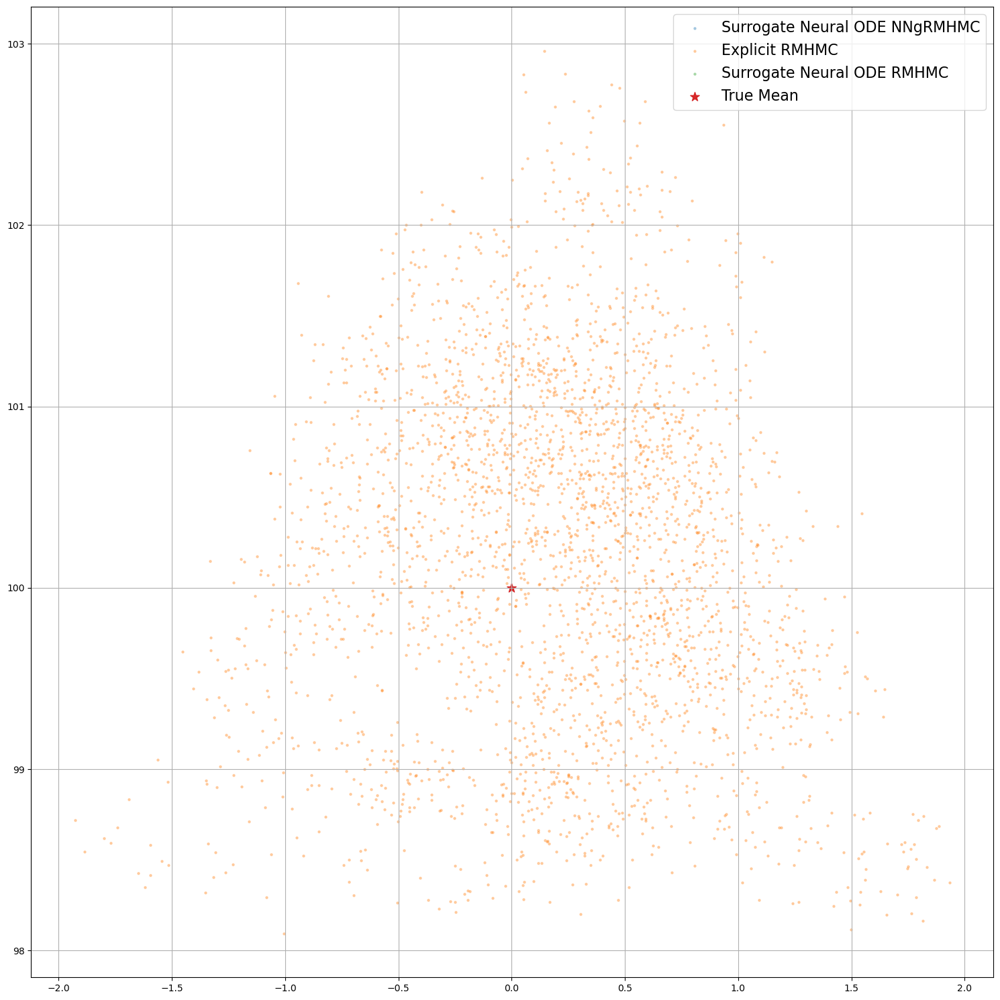

In [ ]:

fs=16

fig, axs = plt.subplots(1, 1, figsize=(15,15))

# axs.scatter(coords_hmc[:,0], coords_hmc[:,1],s=5,alpha=0.3,label='HMC')
# axs.scatter(coords_nuts[:,0], coords_nuts[:,1],s=5,alpha=0.3,label='NUTS')
# axs.scatter(coords_surrogate[:,0], coords_surrogate[:,1],s=5,alpha=0.3,label='Surrogate HMC')
# axs.scatter(coords_surrogate_ode[:,0], coords_surrogate_ode[:,1],s=5,alpha=0.3,label='Surrogate Neural ODE')
# axs.scatter(coords_surrogate_ode_explicit[:,0], coords_surrogate_ode_explicit[:,1],s=5,alpha=0.3,label='Surrogate Neural ODE Explicit')
axs.scatter(coords_surrogate_ode_nngrmhmc[:,0], coords_surrogate_ode_nngrmhmc[:,1],s=5,alpha=0.3,label='Surrogate Neural ODE NNgRMHMC')
# axs.scatter(coords_i_rmhmc[:,0], coords_i_rmhmc[:,1],s=5,alpha=0.3,label='Implicit RMHMC')
axs.scatter(coords_e_rmhmc[:,0], coords_e_rmhmc[:,1],s=5,alpha=0.3,label='Explicit RMHMC')
axs.scatter(coords_surrogate_ode_explicit_rmhmc[:,0], coords_surrogate_ode_explicit_rmhmc[:,1], s = 5, alpha = .3, label = "Surrogate Neural ODE RMHMC")

axs.scatter(0,100,marker = '*',color='C3',s=100,label='True Mean')
axs.legend(fontsize=fs)
axs.grid()
# axs.set_xlim(xlim)
# axs.set_ylim(ylim)


plt.tight_layout()

# plt.savefig('../../Gaussian_plots.png',bbox_inches='tight')
plt.show()

2500.0

# Sampling from a more complicated distribution: Ill conditioned Gaussian

* This is our new `log_prob_func`.

In [ ]:
hamiltorch.set_random_seed(123)
D = 30 
diagonal = torch.distributions.Uniform(0, 100).sample(sample_shape=(D,))
diagonal[0] = .1
diagonal[-1] = 1000
def log_prob_func(w):
    ll = torch.distributions.MultivariateNormal(torch.zeros(D), covariance_matrix=torch.diag(diagonal)).log_prob(w).sum()
    return ll

In [ ]:
N = 6000
step_size = .5
L = 100

### Sample using standard HMC
* Initialise the parameters e.g. `params_init = torch.zeros(2)` and pass them into the `hamiltorch.sample()` function as `params_init=params_init`.
* Set the number of samples `num_samples=N` corresponding to the number of momentum resampling steps/the number of trajectories to sample.
* Set the step size and trajectory length via `step_size=step_size, num_steps_per_sample=L`.

In [ ]:
# HMC
hamiltorch.set_random_seed(123)
params_init = torch.zeros(D) 
params_hmc = hamiltorch.sample(log_prob_func=log_prob_func, params_init=params_init, num_samples=N,
                               step_size=step_size, num_steps_per_sample=L, burn = 1000)

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec


0d:00:05:45 | 0d:00:00:00 | #################### | 6000/6000 | 17.37       
Acceptance Rate 0.96


### Sample using the Surrogate HMC Sampler
* As in https://andrewjholbrook.github.io/papers/Li.pdf


In [ ]:
# HMC NUTS
hamiltorch.set_random_seed(123)
params_init = torch.zeros(D)
burn=1000
N_surrogate = N
params_hmc_surrogate, surrogate_model = hamiltorch.sample_surrogate_hmc(log_prob_func=log_prob_func, params_init=params_init,
                                                  num_samples=N_surrogate,step_size=step_size,num_steps_per_sample=L,burn=burn,
                                                  desired_accept_rate=0.8)

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec


Training Surrogate Model8 | ###----------------- |  995/6000 | 17.33       
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:04:40 | 0d:00:00:00 | #################### | 5000/5000 | 17.86       
Acceptance Rate 0.00


### Sample using the Surrogate HMC Sampler With Neural Dynamics
* We replace the Hamiltonian and integrator with the Neural ODE

In [ ]:
%load_ext autoreload

%autoreload 2


hamiltorch.set_random_seed(123)
params_init = torch.zeros(D)
burn=1000
N_surrogate_ode = N
params_hmc_surrogate_ode, surrogate_model_ode = hamiltorch.sample_neural_ode_surrogate_hmc(log_prob_func=log_prob_func, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn,model_type="implicit_hamiltonian"
                                                  )

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Sampling (Sampler.HMC; Integrator.IMPLICIT)


Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model
0d:02:06:40 | 0d:00:00:00 | #################### | 6000/6000 | 0.79         
Acceptance Rate 0.16


### Sample using the Surrogate HMC Sampler With Neural Dynamics (Explicit hamiltonian )
* We replace the Hamiltonian and integrator with the Neural ODE

In [ ]:
hamiltorch.set_random_seed(123)
params_init = torch.zeros(D) 
burn=1000
N_surrogate_ode = N
params_hmc_surrogate_ode_explicit, surrogate_model_ode_explicit = hamiltorch.sample_neural_ode_surrogate_hmc(log_prob_func=log_prob_func, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn, model_type="explicit_hamiltonian"
                                                  )

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec


Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model


### Sample using the Surrogate HMC Sampler With Neural Dynamics (Estimate Gradient )
* We replace the  integrator with the Neural ODE gradient

In [ ]:
hamiltorch.set_random_seed(123)
params_init = torch.zeros(D) 
burn=1000
N_surrogate_ode = N
params_hmc_surrogate_ode_nnghmc, surrogate_model_ode_nnghmc = hamiltorch.sample_neural_ode_surrogate_hmc(log_prob_func=log_prob_func, params_init=params_init,
                                                  num_samples=N_surrogate_ode,step_size=step_size,num_steps_per_sample=L,burn=burn, model_type=""
                                                  )

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Your vector field callable (nn.Module) should have both time `t` and state `x` as arguments, we've wrapped it for you.
Training Surrogate ODE Model
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60])
torch.Size([1000, 60

### Convert samples to numpy arrays to plot using matplotlib

In [ ]:
coords_hmc = torch.cat(params_hmc).reshape(len(params_hmc),-1).numpy()
coords_surrogate_ode = torch.cat(params_hmc_surrogate_ode).reshape(len(params_hmc_surrogate_ode),-1).numpy()
coords_surrogate = torch.cat(params_hmc_surrogate).reshape(len(params_hmc_surrogate),-1).numpy()
coords_surrogate_ode_nnghmc = torch.cat(params_hmc_surrogate_ode_nnghmc).reshape(len(params_hmc_surrogate_ode_nnghmc),-1).numpy()

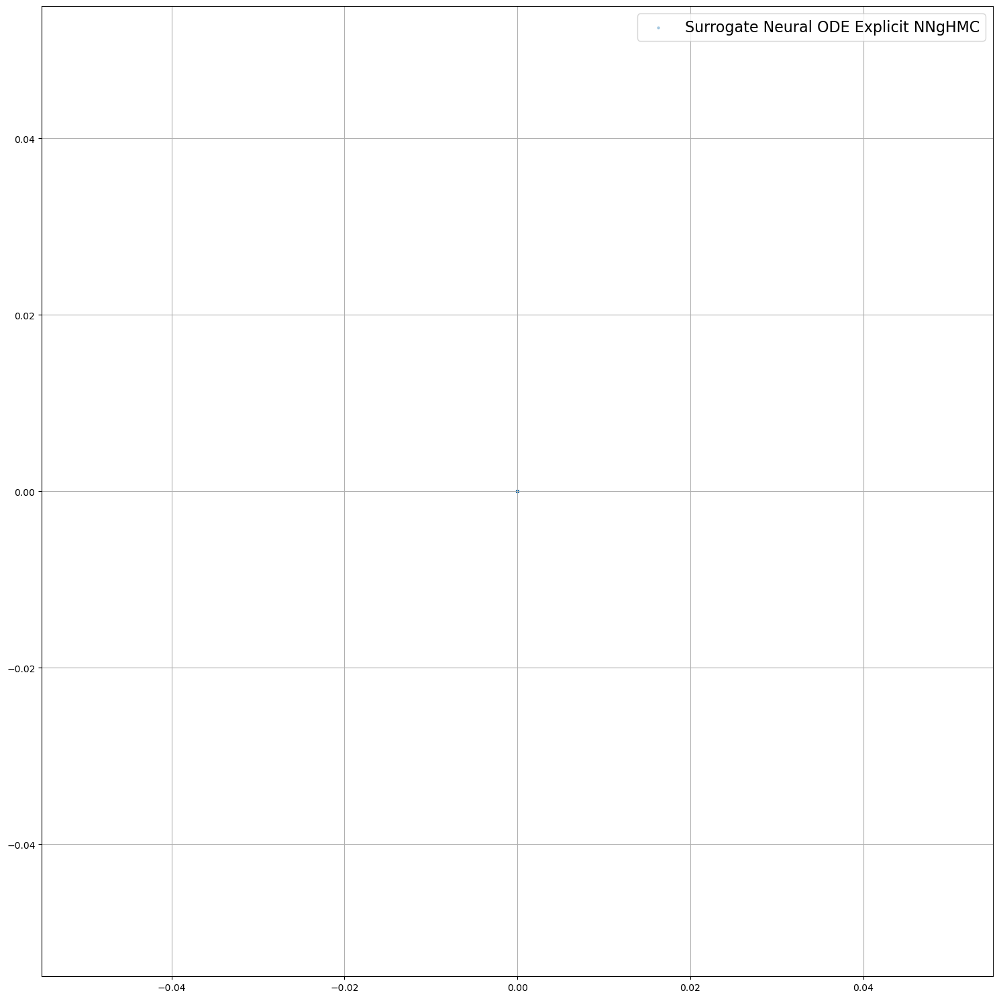

In [ ]:

fs=16

fig, axs = plt.subplots(1, 1, figsize=(15,15))

axs.scatter(coords_hmc[:,0], coords_hmc[:,1],s=5,alpha=0.3,label='HMC')
axs.scatter(coords_surrogate[:,0], coords_surrogate[:,1],s=5,alpha=0.3,label='Surrogate HMC')
axs.scatter(coords_surrogate_ode[:,0], coords_surrogate_ode[:,1],s=5,alpha=0.3,label='Surrogate Neural ODE')
axs.scatter(coords_surrogate_ode_nnghmc[:,0], coords_surrogate_ode_nnghmc[:,1],s=5,alpha=0.3,label='Surrogate Neural ODE Explicit NNgHMC')

# axs.scatter(mean[0],mean[1],marker = '*',color='C3',s=100,label='True Mean')
axs.legend(fontsize=fs)
axs.grid()
# axs.set_xlim(xlim)
# axs.set_ylim(ylim)


plt.tight_layout()

# plt.savefig('../../Gaussian_plots.png',bbox_inches='tight')
plt.show()

In [1]:
import hamiltorch

/home/abhijitbrahme/.conda/envs/approx-hmc/lib/python3.11/site-packages/torch/cuda/__init__.py:628: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


Running experiment for: solver: SynchronousLeapfrog, sensitivity: autograd, distribution: banana, model: HMC
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:00:11 | 0d:00:00:00 | #################### | 6000/6000 | 514.54       
Acceptance Rate 0.99
Running experiment for: solver: SynchronousLeapfrog, sensitivity: autograd, distribution: banana, model: NNgHMC
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Training Surrogate Model1 | #------------------- |  244/6000 | 489.47       
took 99 epochs
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:00:08 | 0d:00:00:00 | #################### | 5700/5700 | 664.39       
Acceptance Rate 0.55
Running experiment for: solver: SynchronousLeapfrog, sensitivity: autograd, distribution: banana, model: Explicit NNODEgHMC
Sampling (

/home/abhijitbrahme/.conda/envs/approx-hmc/lib/python3.11/site-packages/hamiltorch/plot_utils.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(2, 2, figsize=(15,15), sharex=True, sharey=True)


Running experiment for: solver: SynchronousLeapfrog, sensitivity: autograd, distribution: normal_normal, model: HMC
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:00:38 | 0d:00:00:00 | #################### | 6000/6000 | 156.03       
Acceptance Rate 1.00
Running experiment for: solver: SynchronousLeapfrog, sensitivity: autograd, distribution: normal_normal, model: NNgHMC
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
Training Surrogate Model4 | ###----------------- |  877/6000 | 150.36       
took 99 epochs
Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:00:25 | 0d:00:00:00 | #################### | 5100/5100 | 200.77       
Acceptance Rate 0.95
Running experiment for: solver: SynchronousLeapfrog, sensitivity: autograd, distribution: normal_normal, model: Explicit

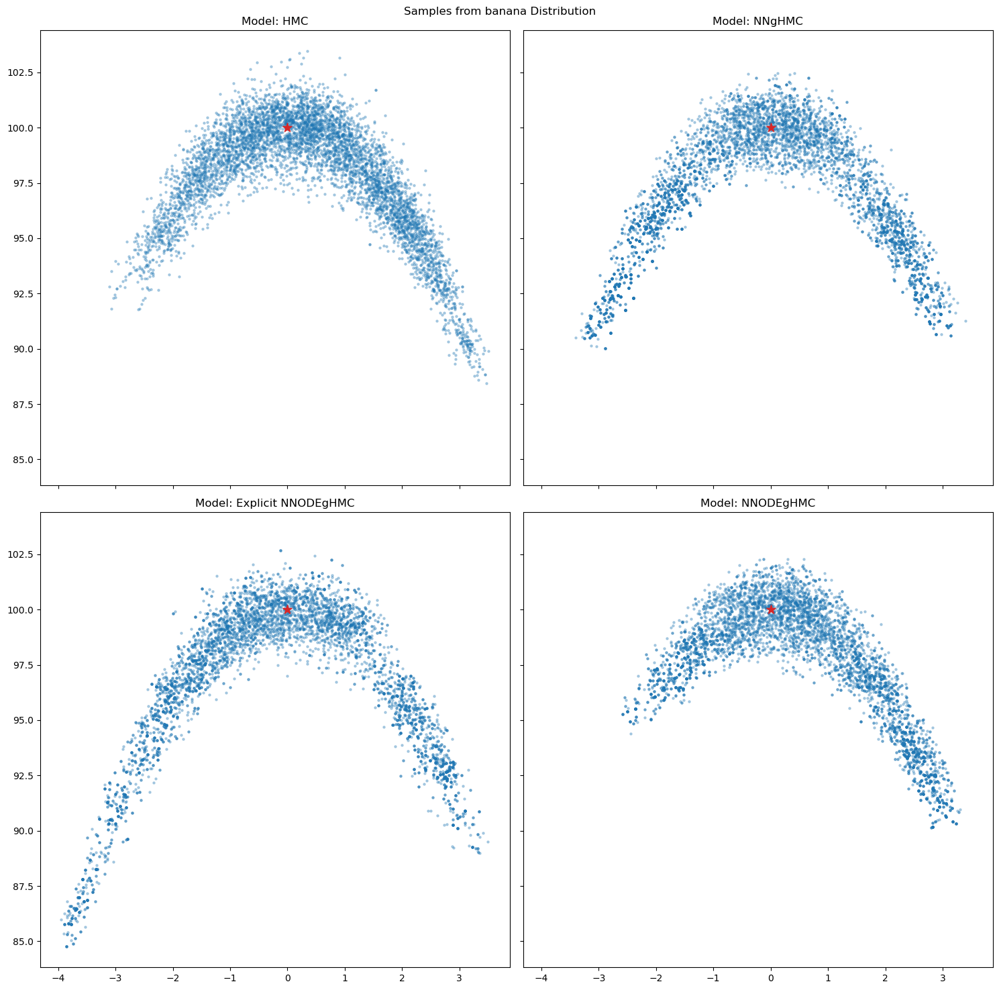

<Figure size 1500x1500 with 0 Axes>

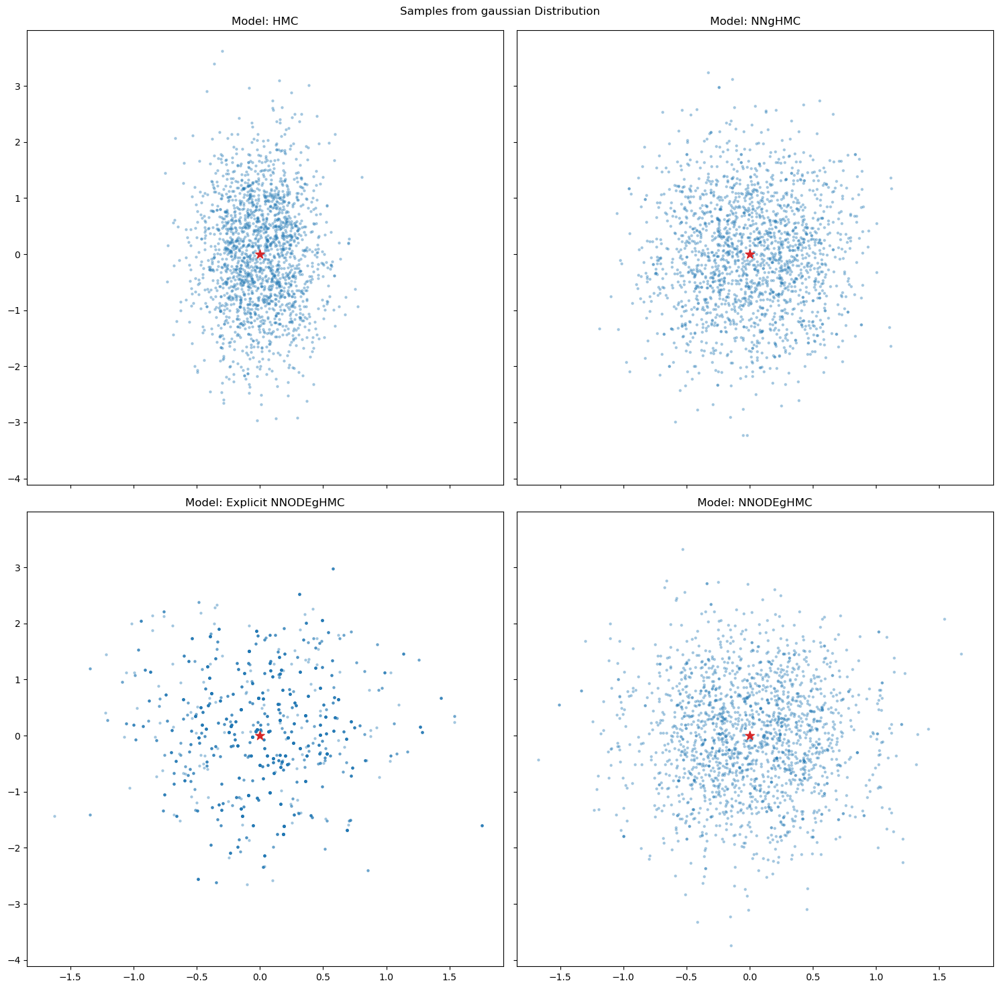

<Figure size 1500x1500 with 0 Axes>

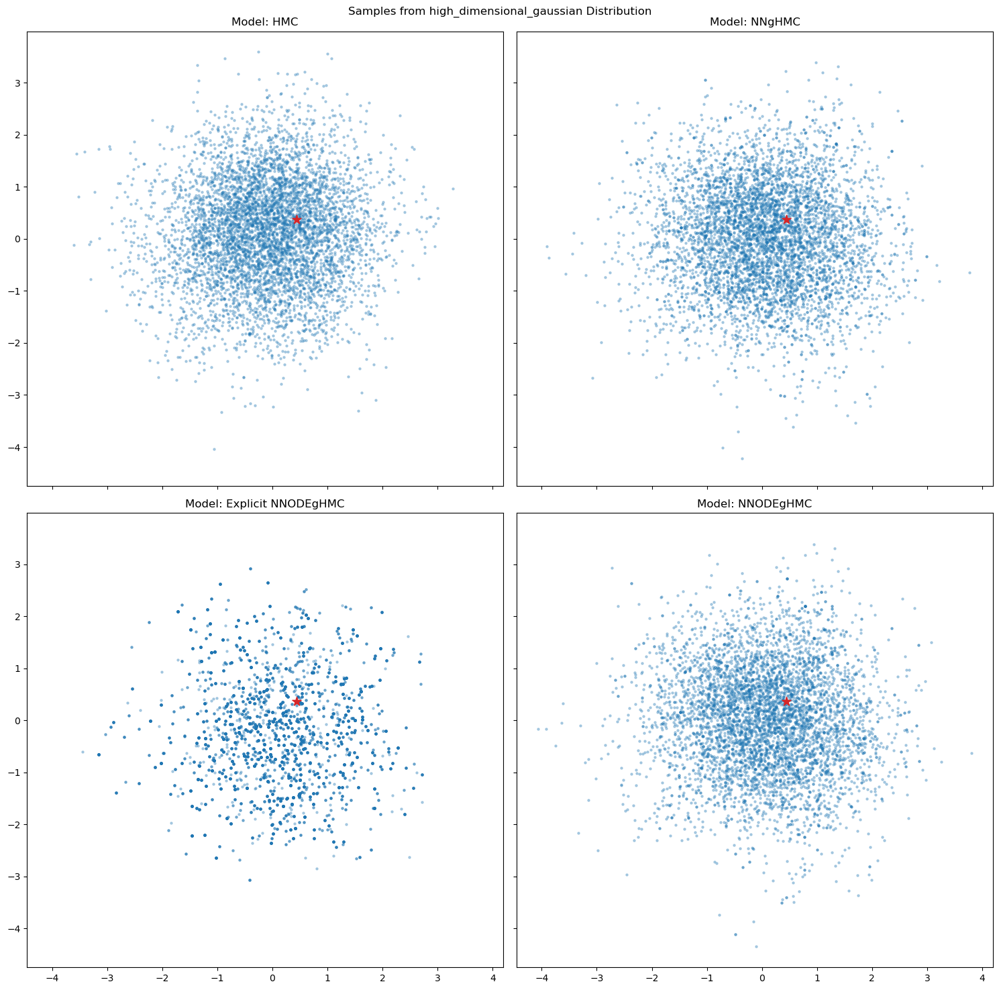

<Figure size 1500x1500 with 0 Axes>

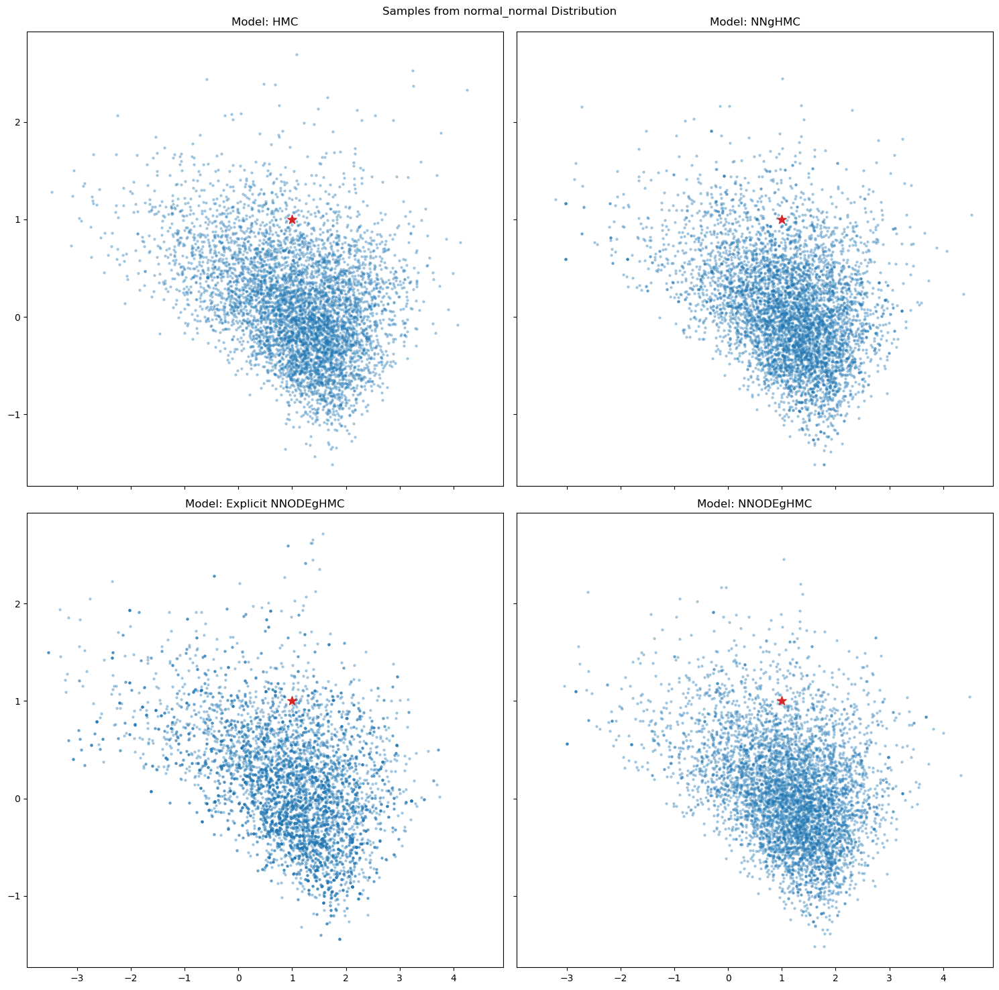

<Figure size 1500x1500 with 0 Axes>

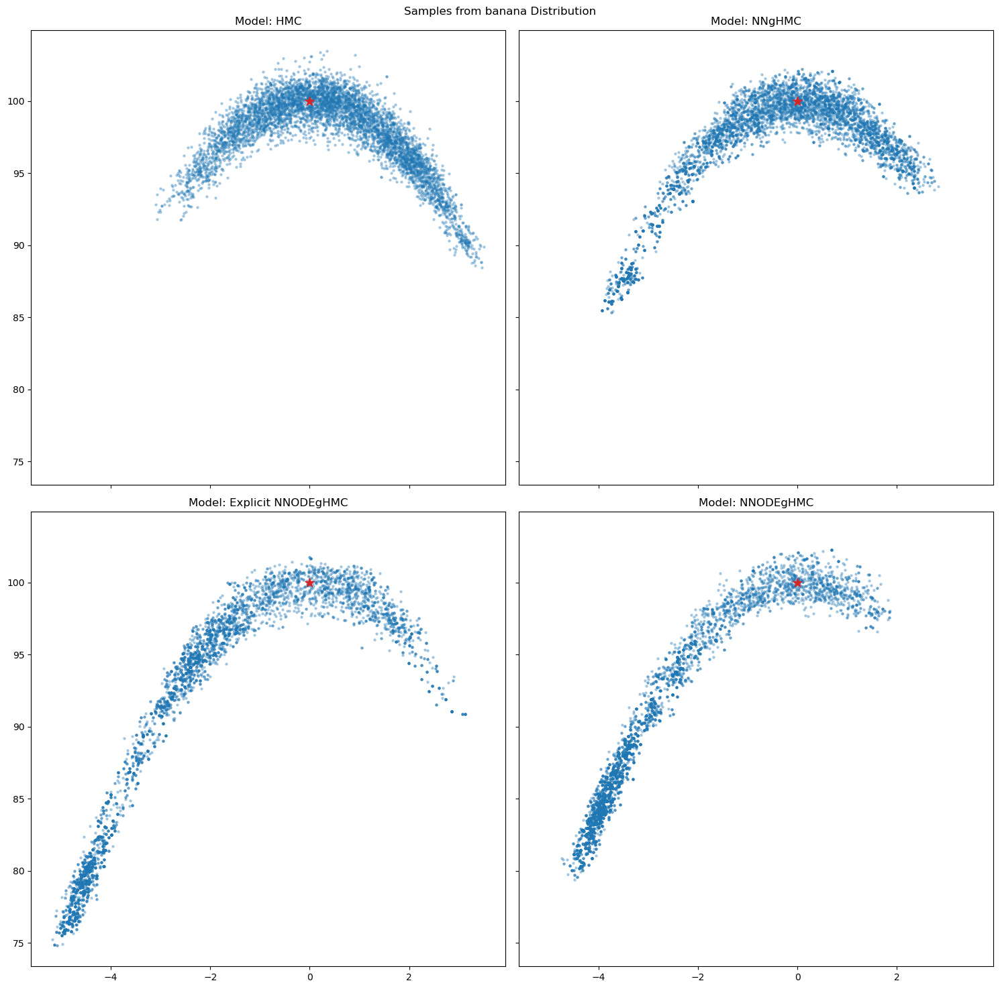

<Figure size 1500x1500 with 0 Axes>

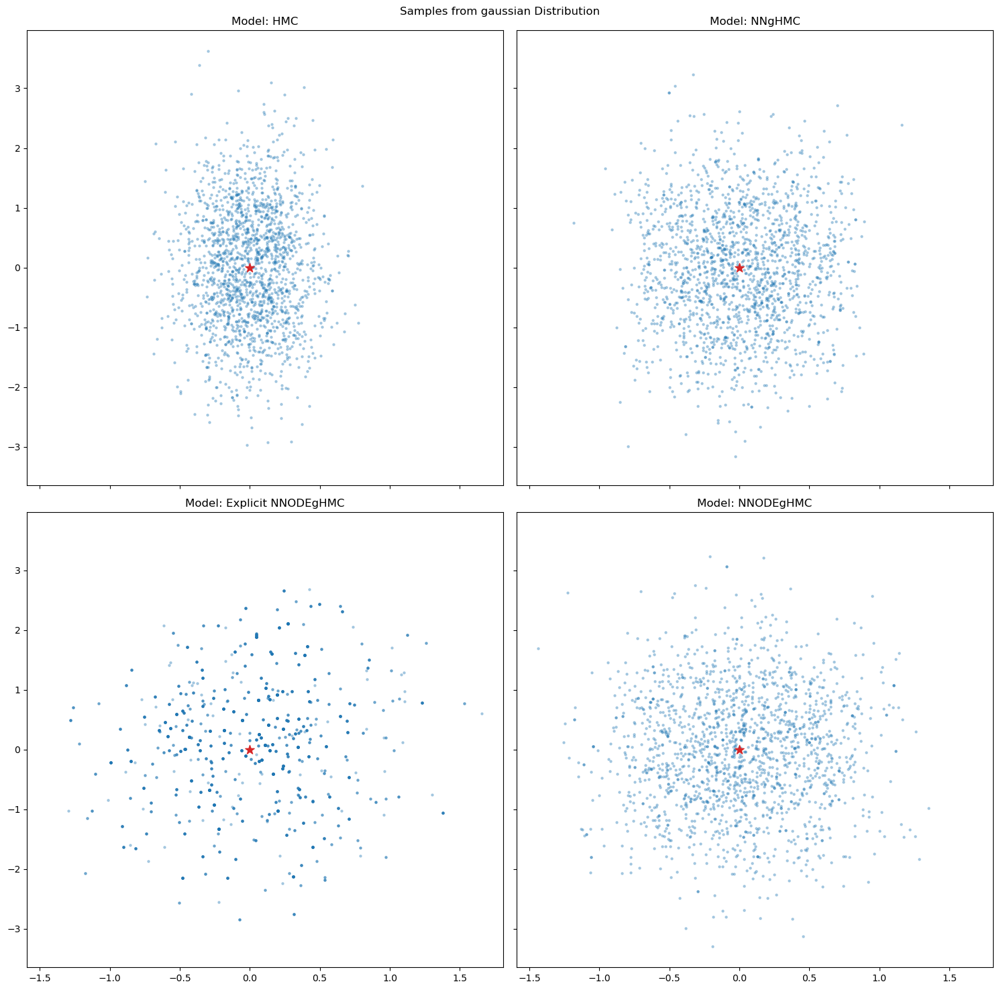

<Figure size 1500x1500 with 0 Axes>

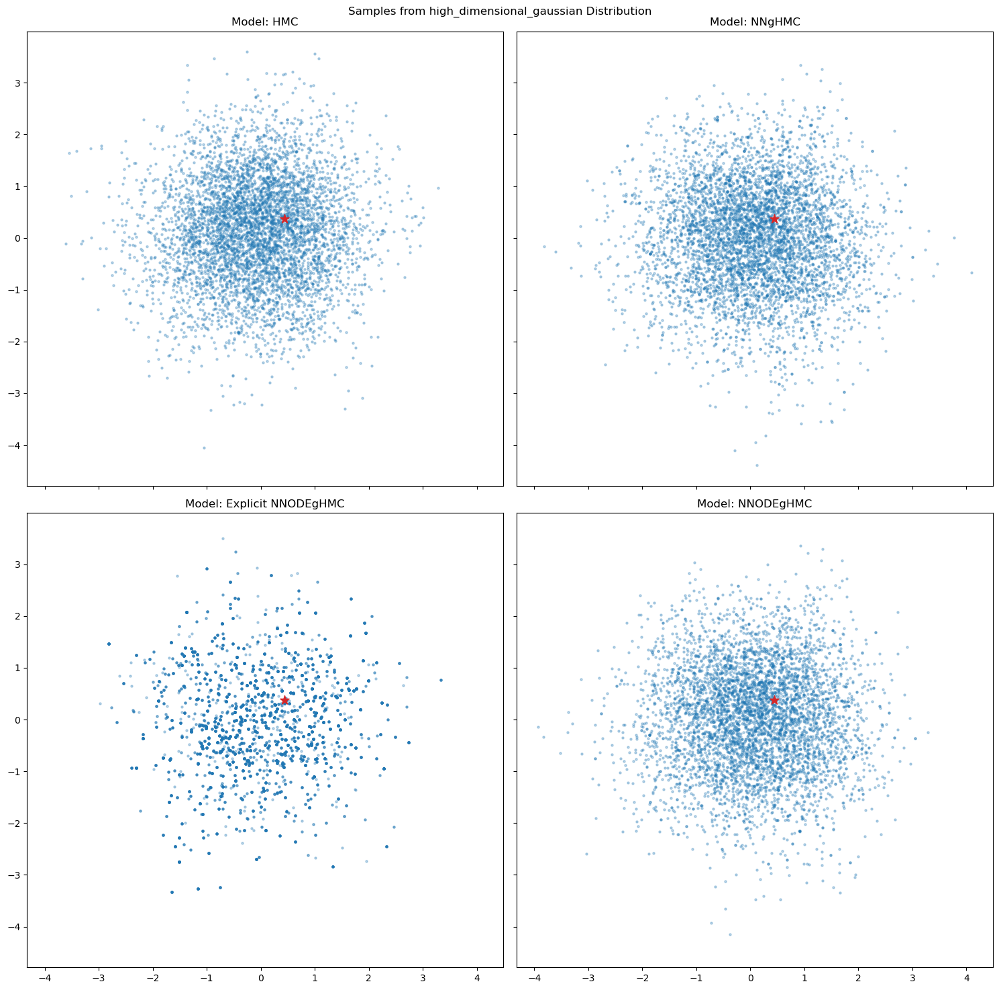

<Figure size 1500x1500 with 0 Axes>

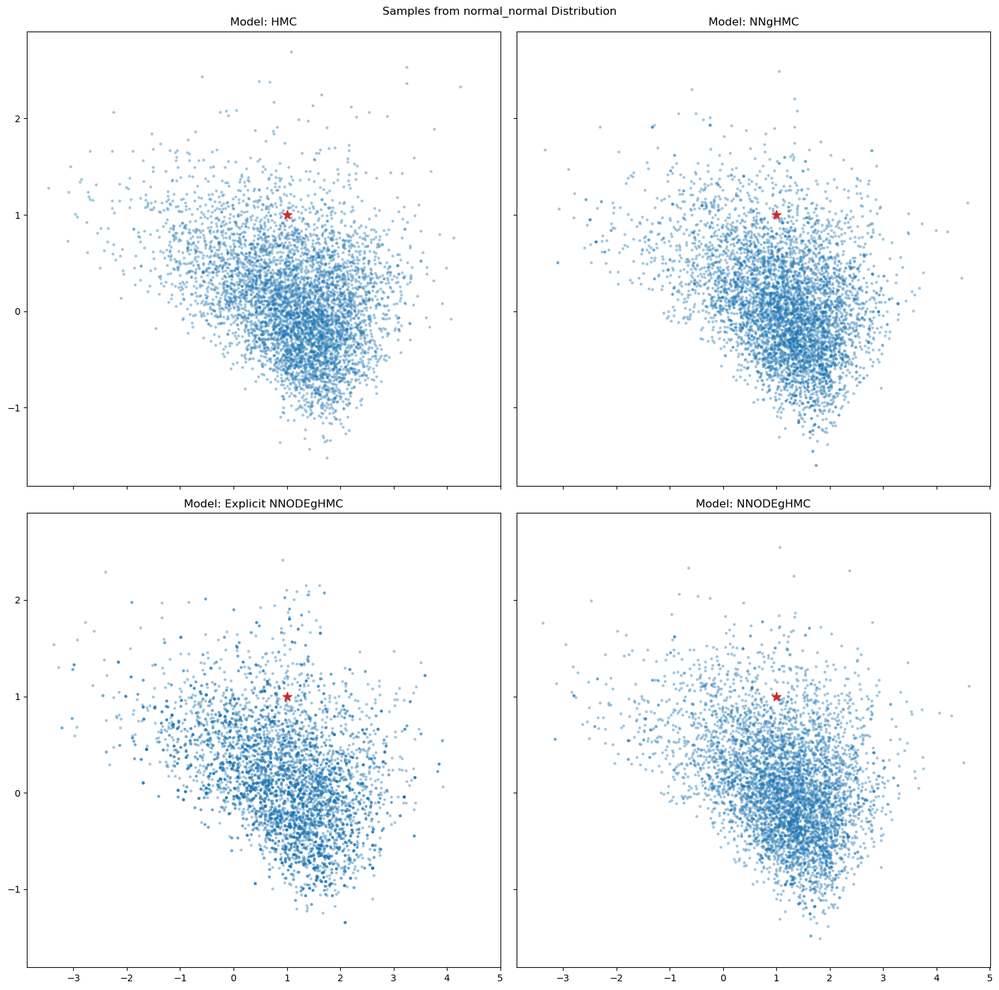

<Figure size 1500x1500 with 0 Axes>

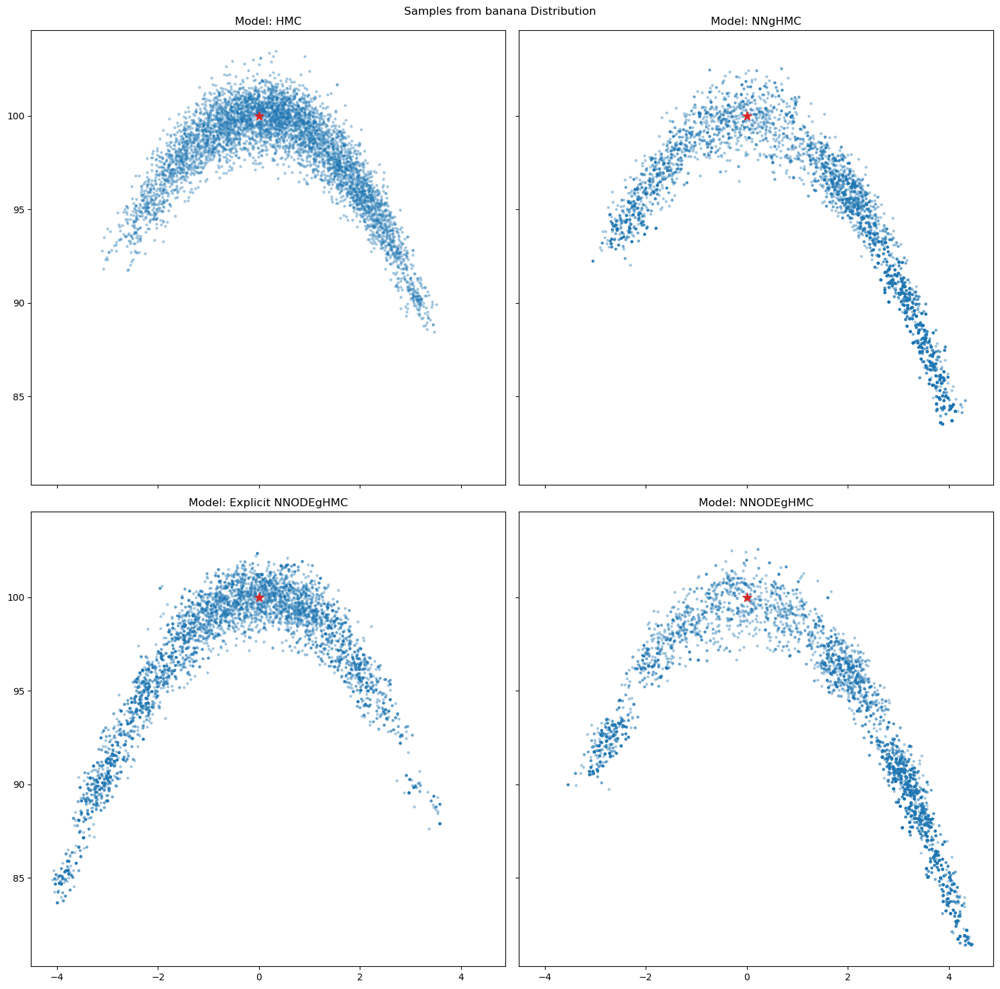

<Figure size 1500x1500 with 0 Axes>

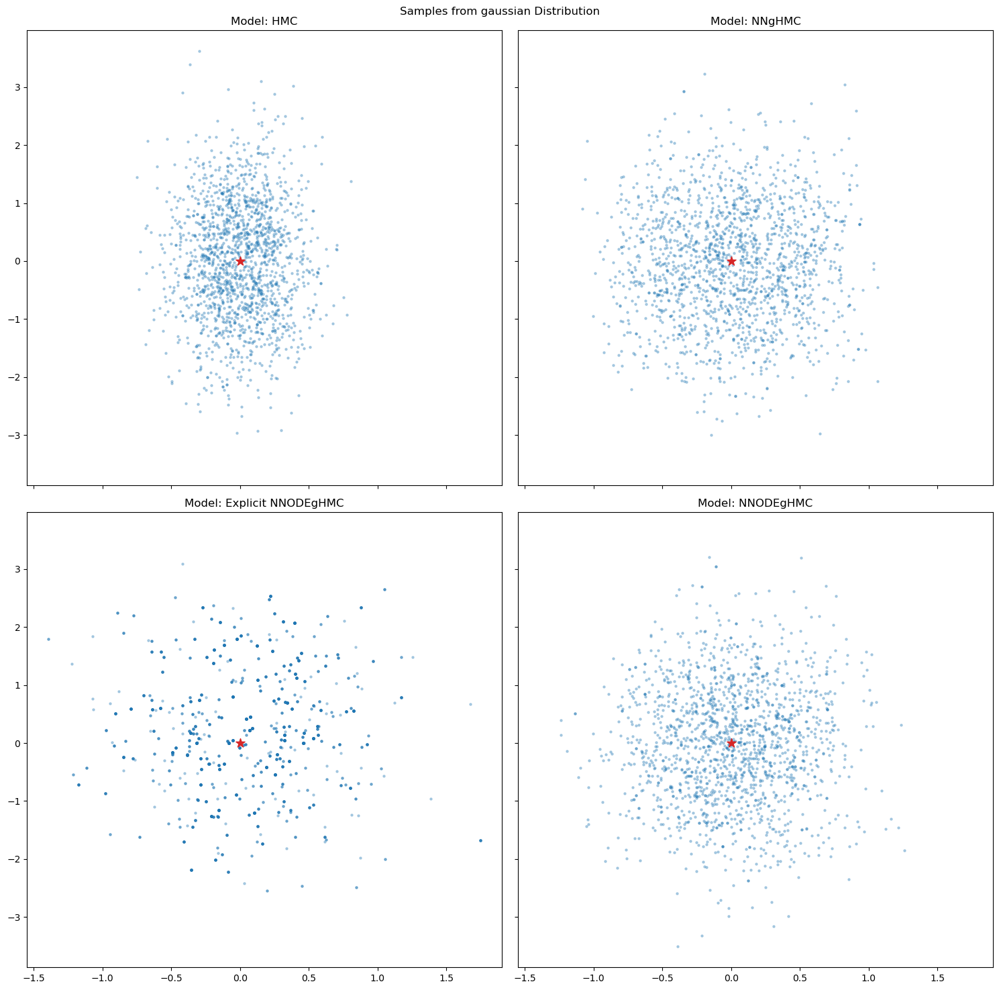

<Figure size 1500x1500 with 0 Axes>

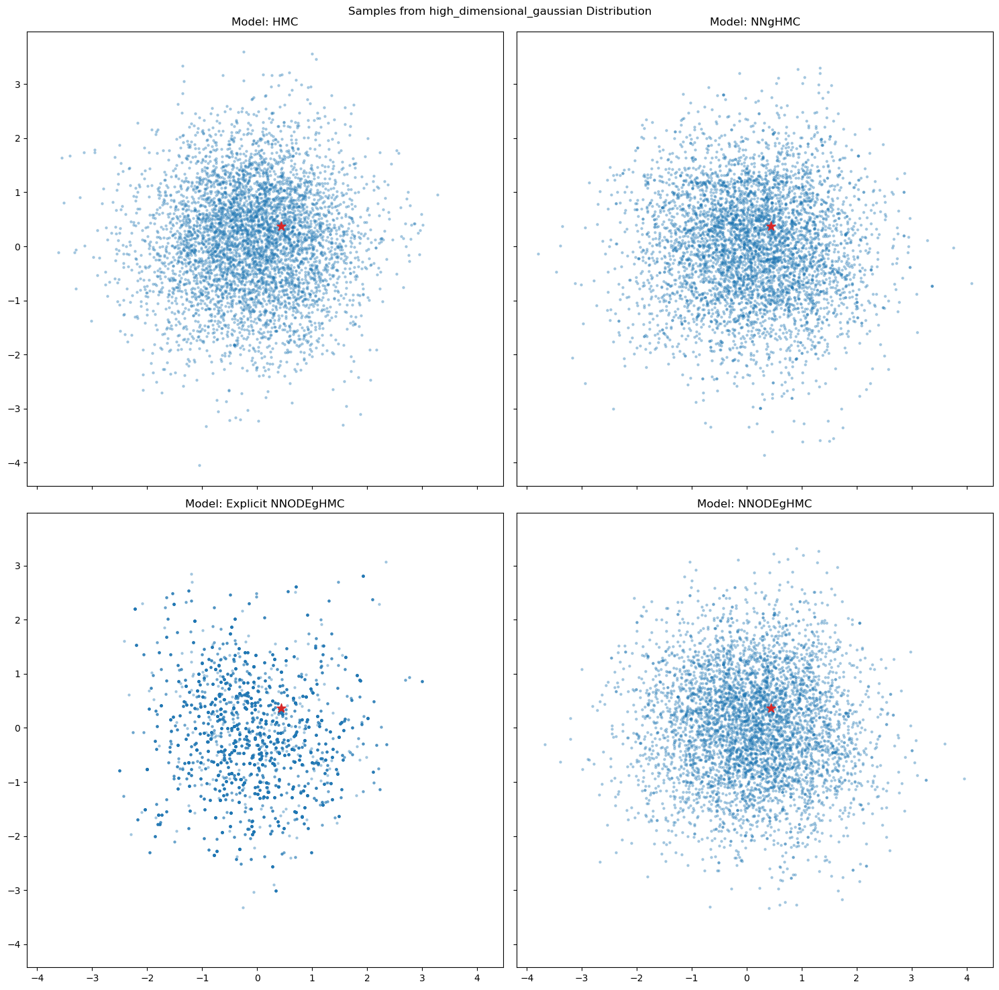

<Figure size 1500x1500 with 0 Axes>

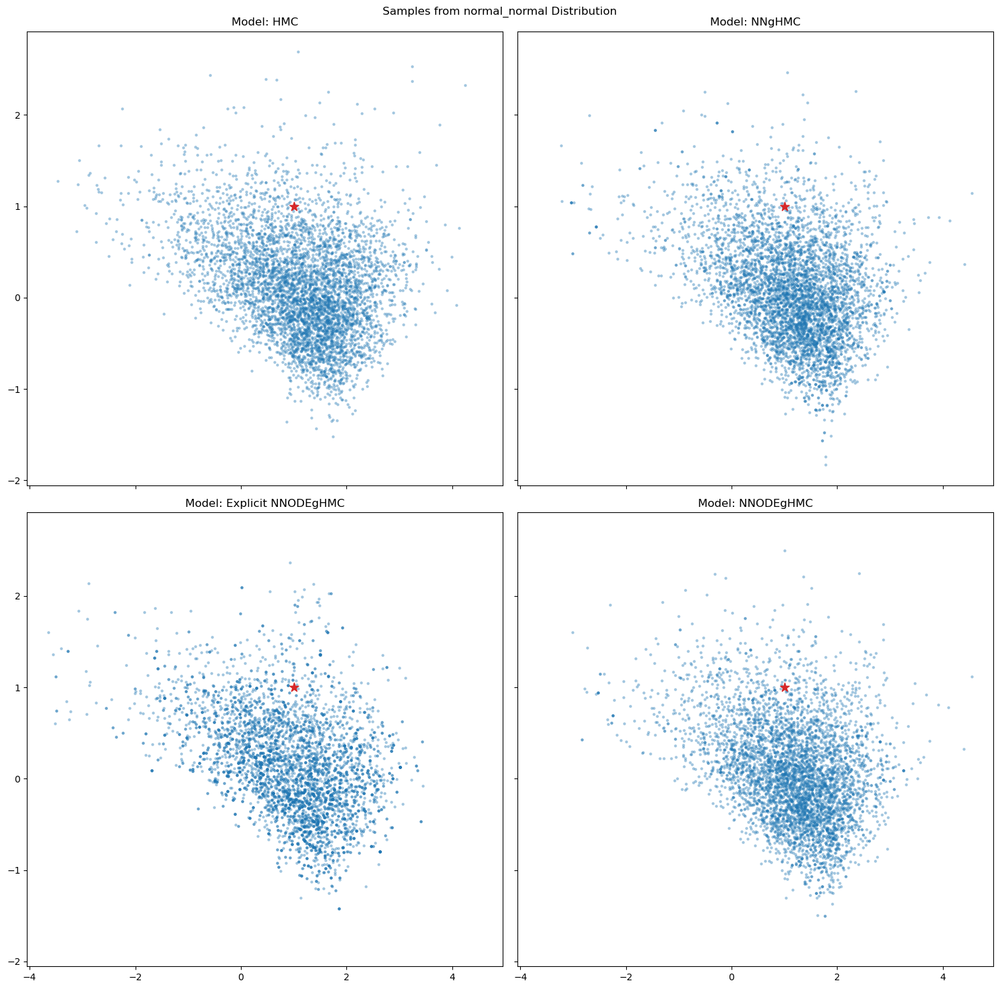

<Figure size 1500x1500 with 0 Axes>

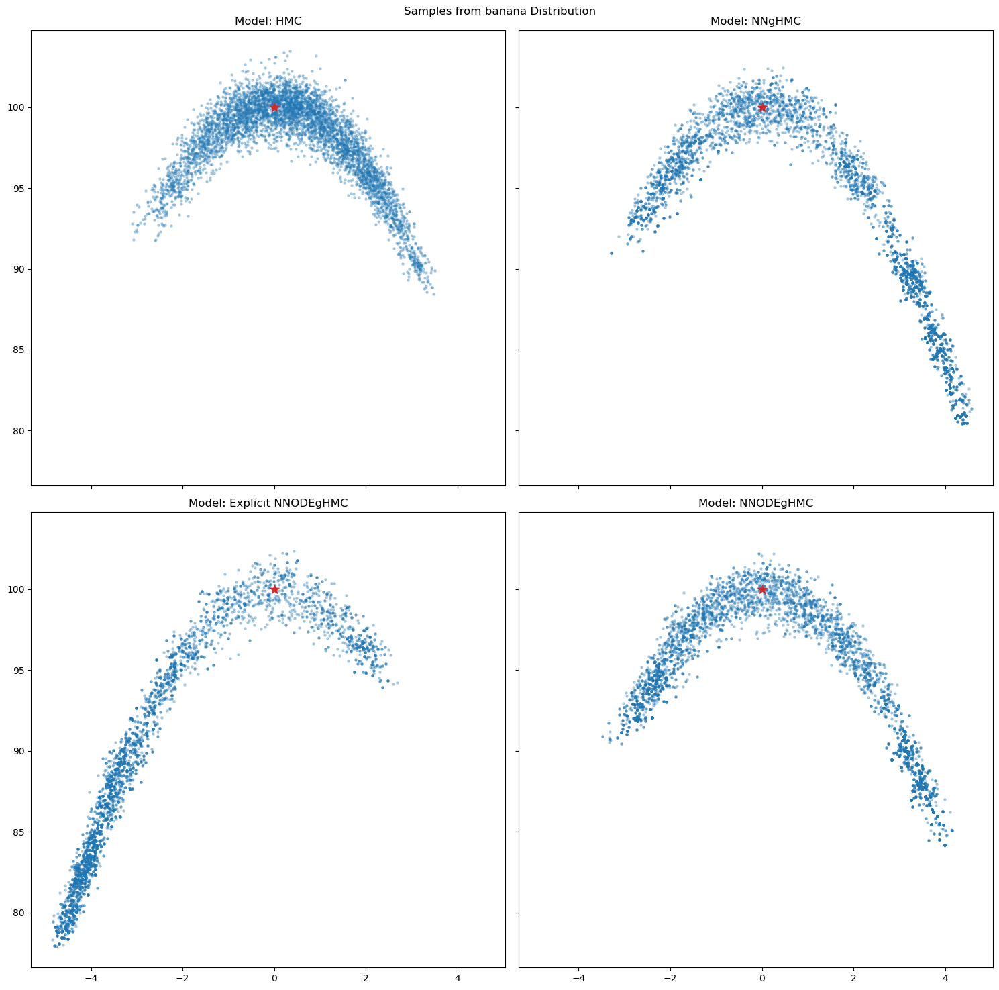

<Figure size 1500x1500 with 0 Axes>

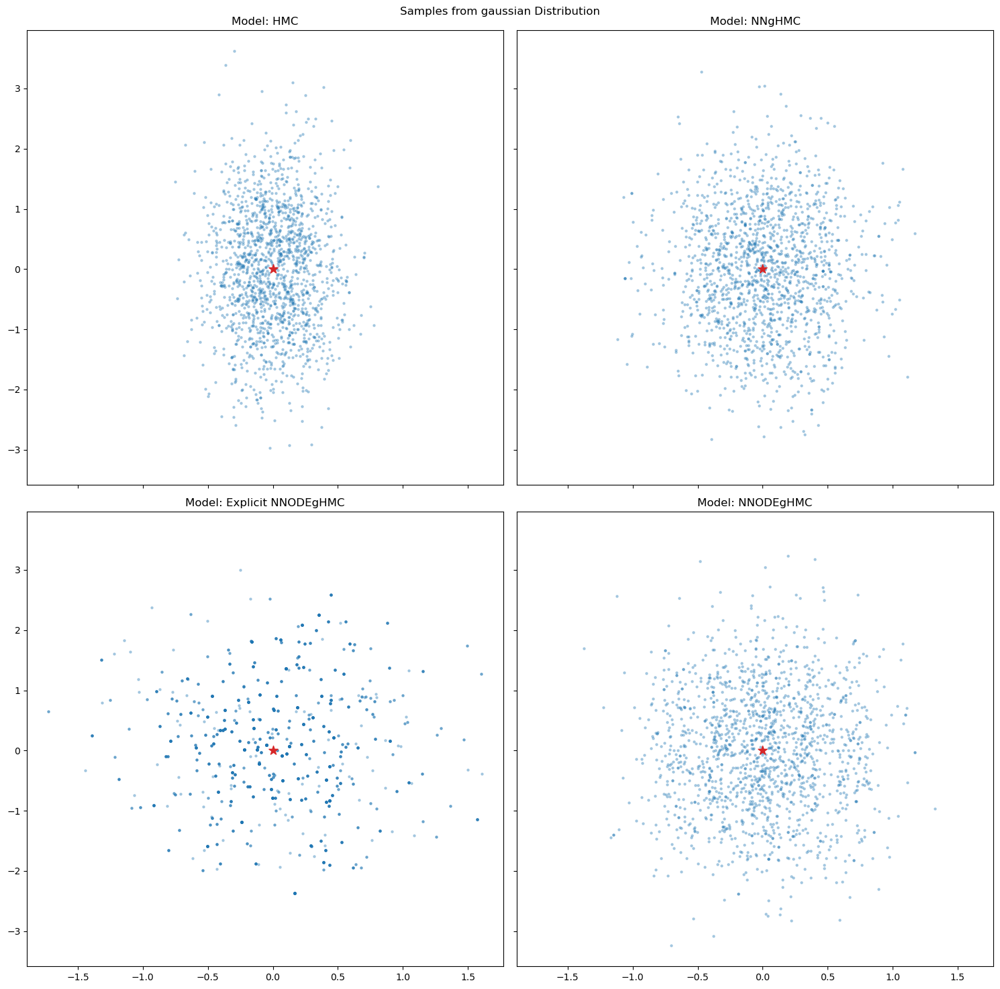

<Figure size 1500x1500 with 0 Axes>

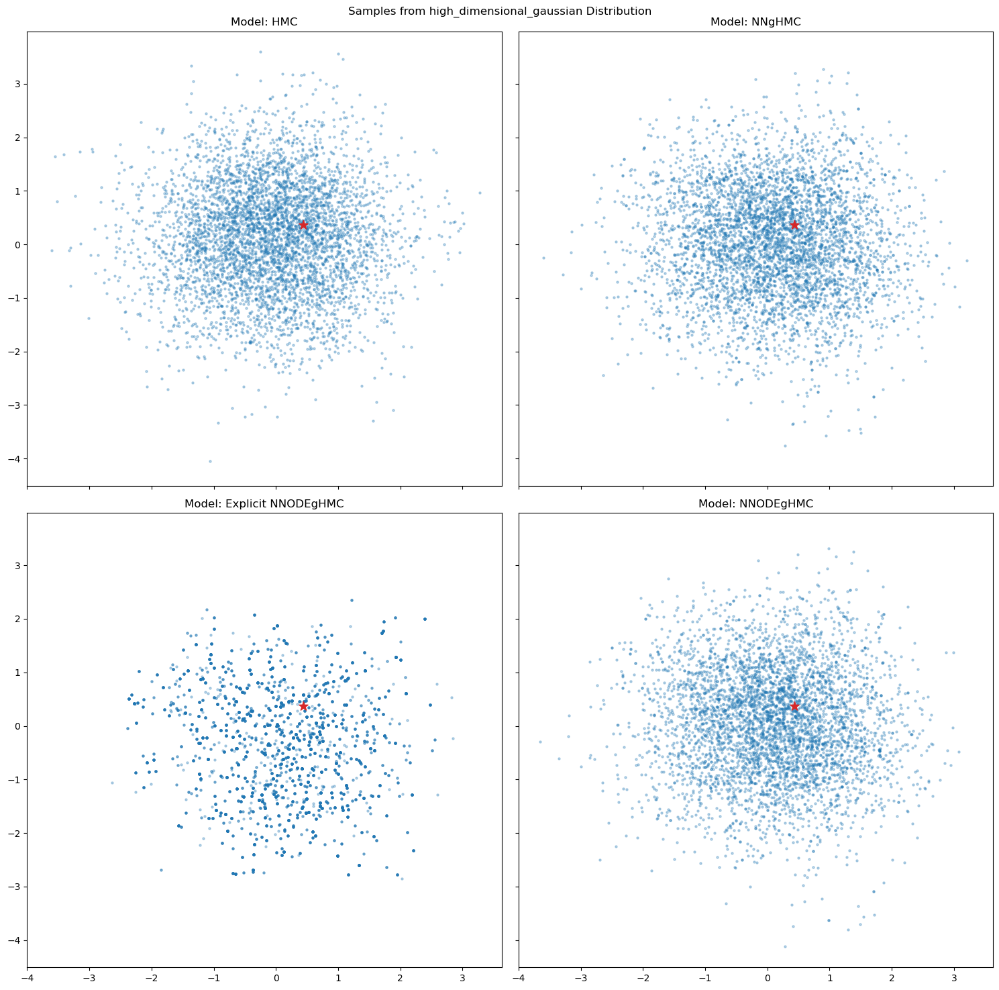

<Figure size 1500x1500 with 0 Axes>

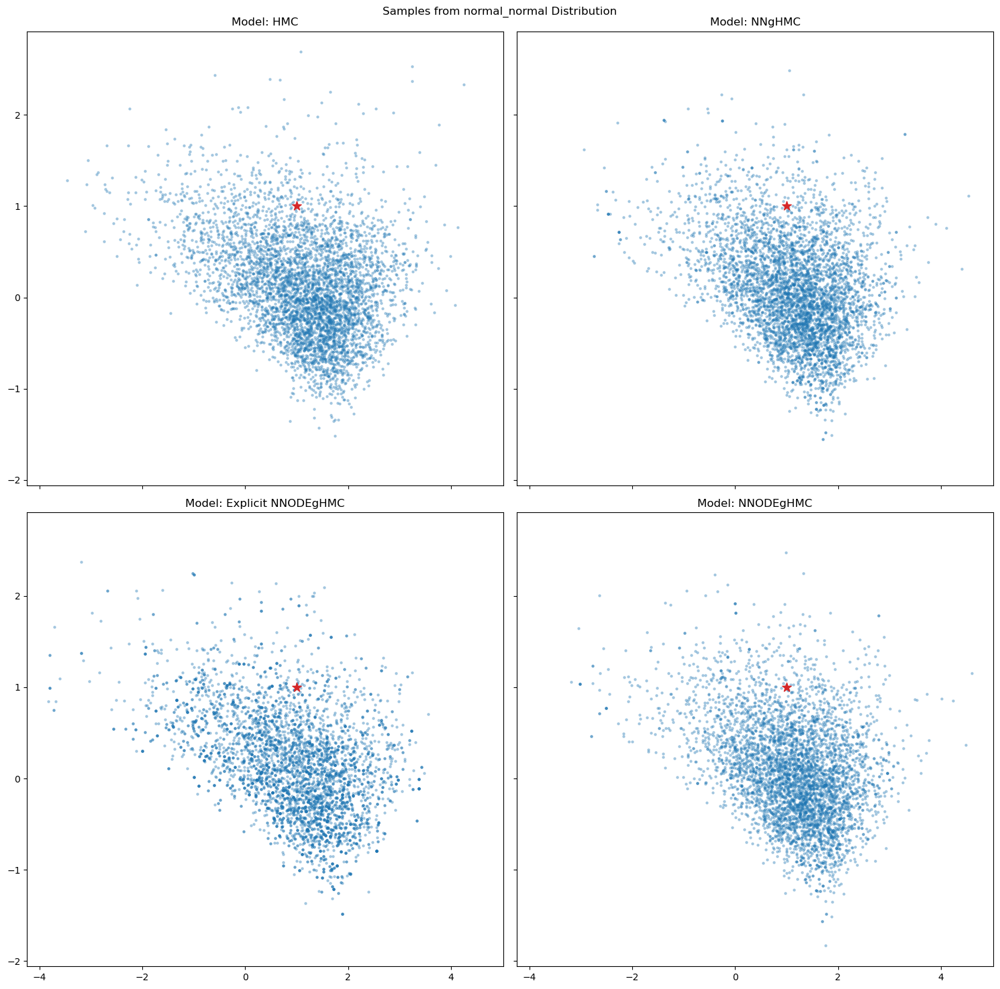

<Figure size 1500x1500 with 0 Axes>

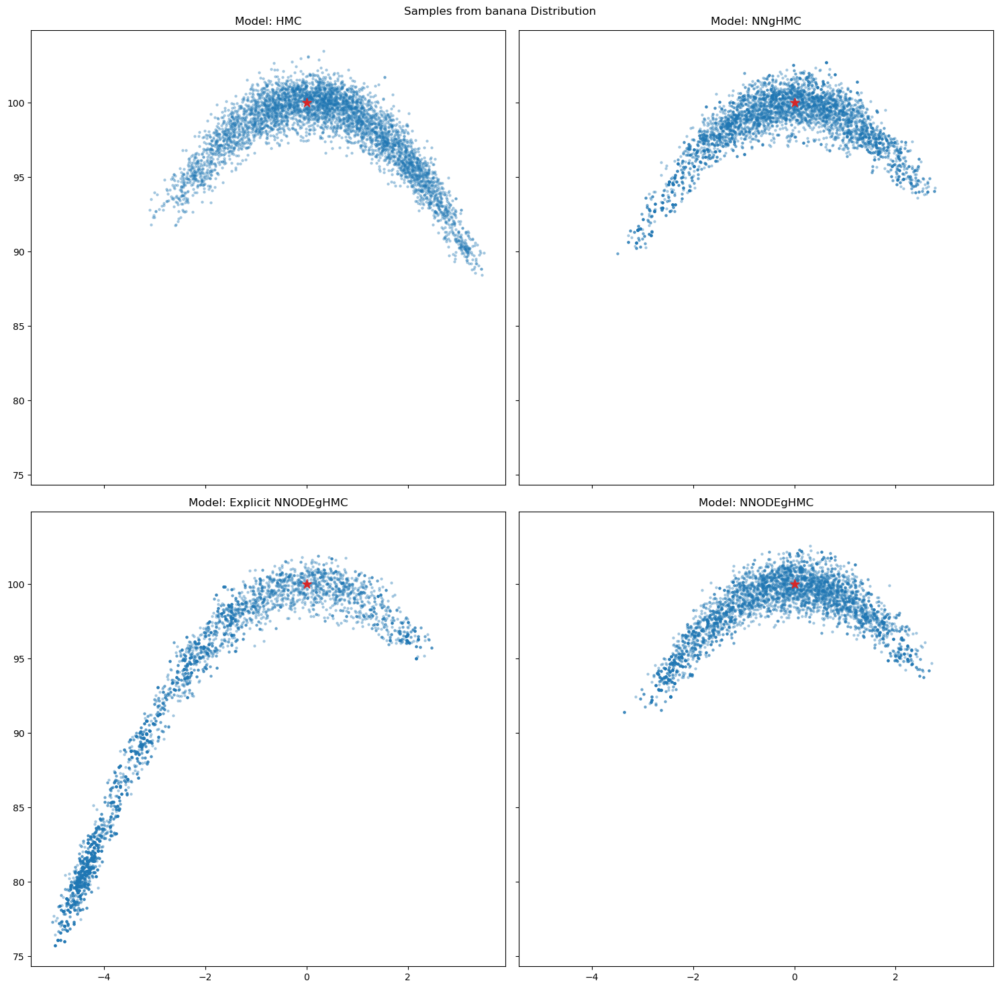

<Figure size 1500x1500 with 0 Axes>

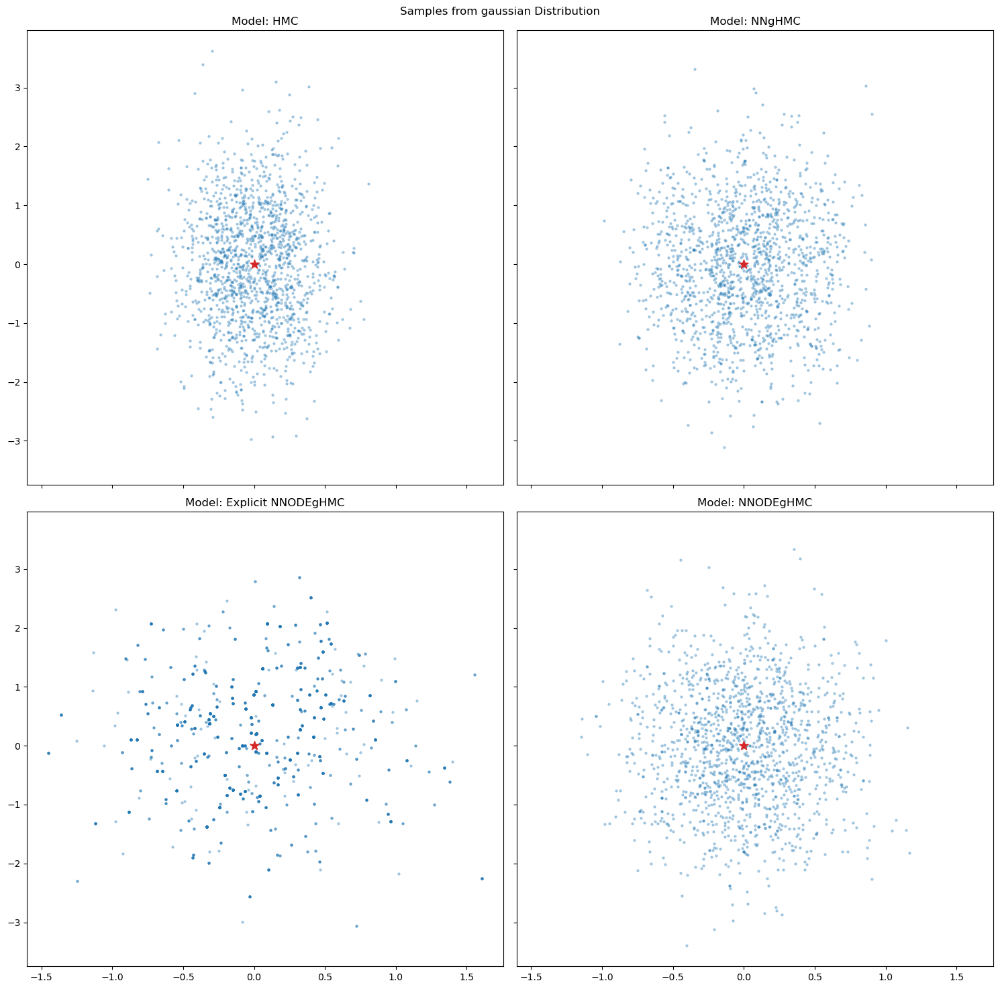

<Figure size 1500x1500 with 0 Axes>

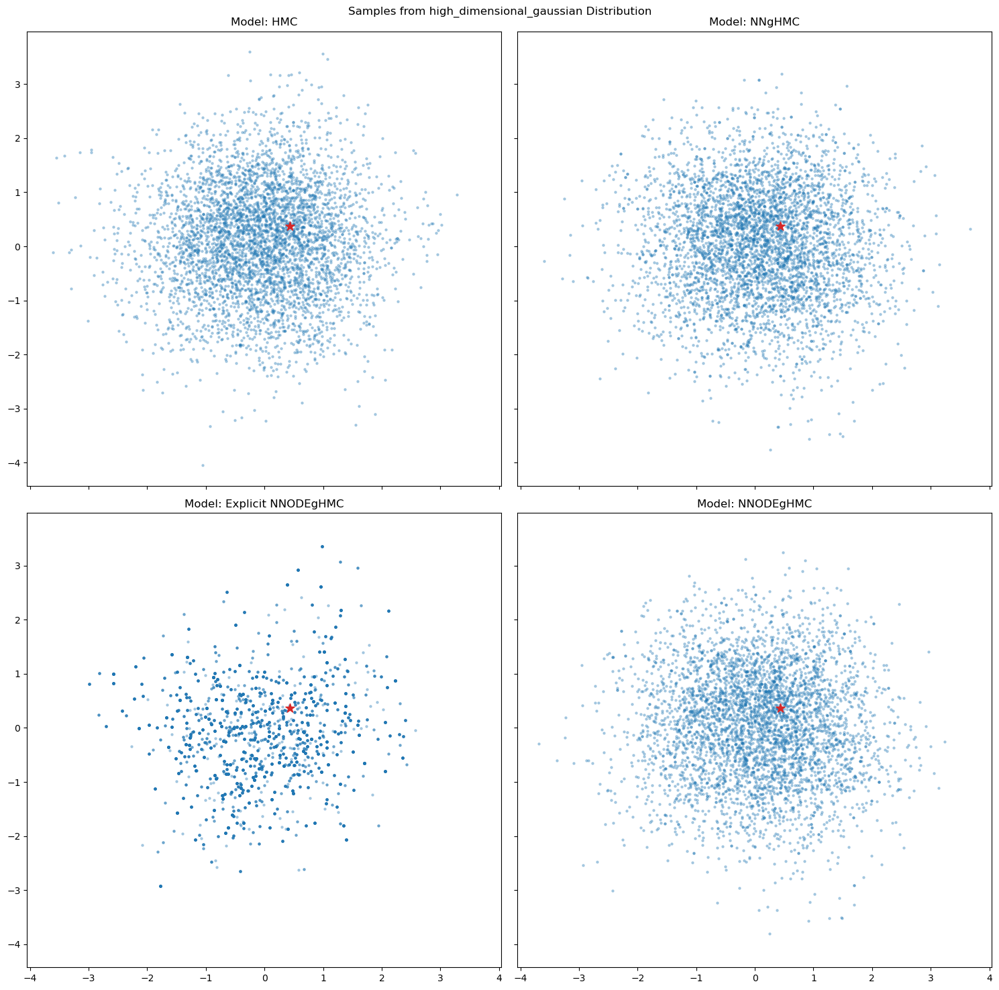

<Figure size 1500x1500 with 0 Axes>

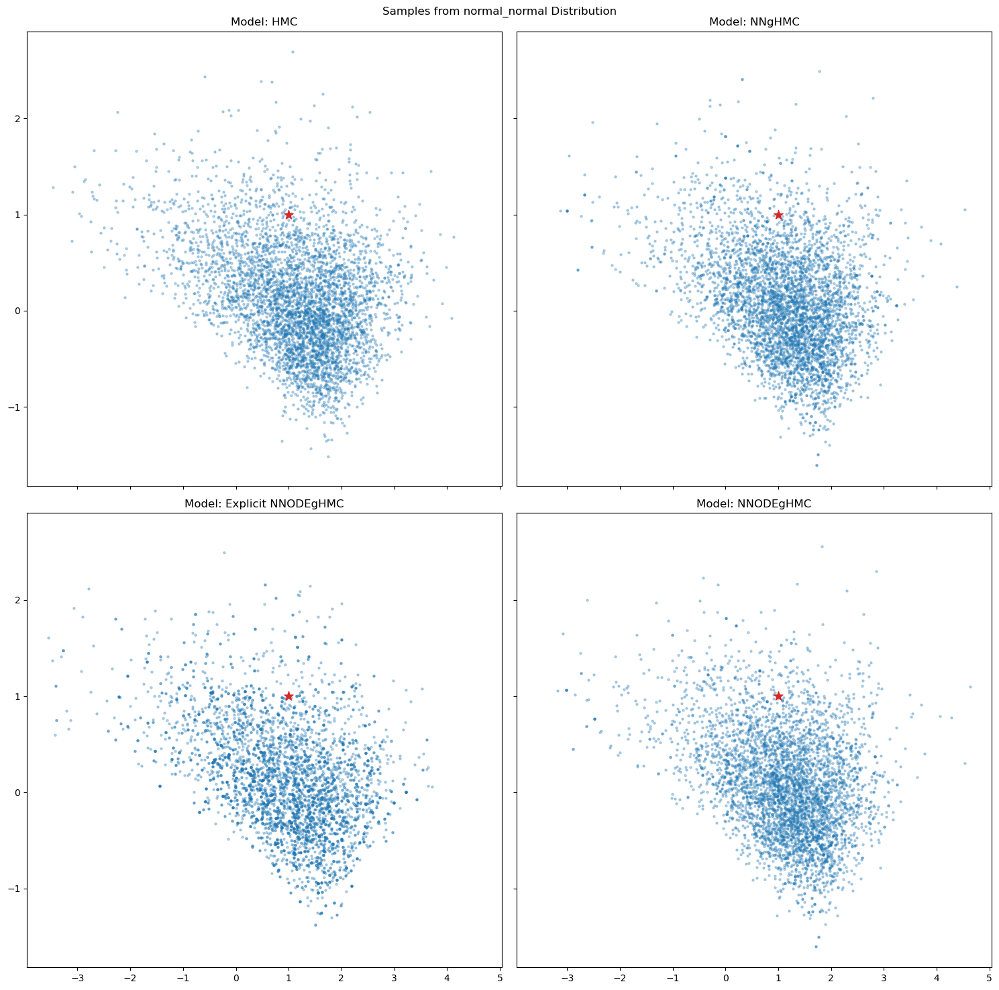

<Figure size 1500x1500 with 0 Axes>

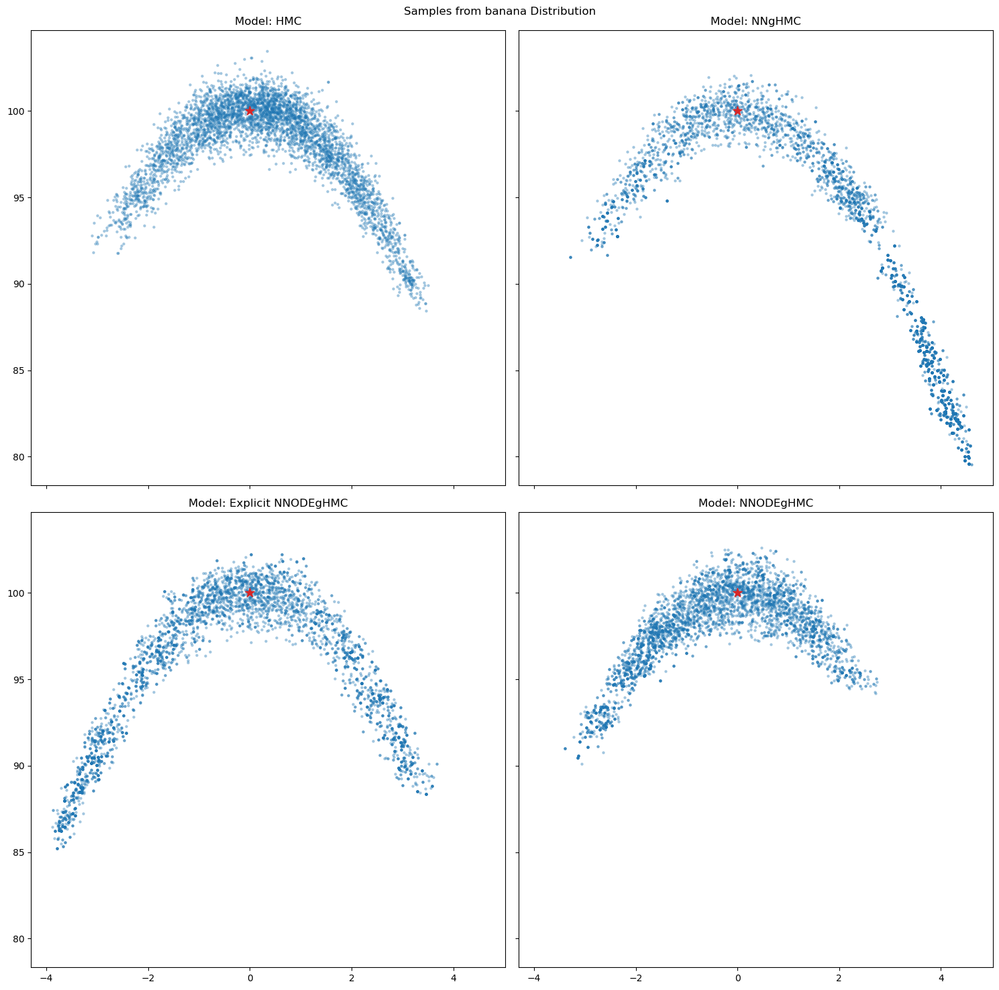

<Figure size 1500x1500 with 0 Axes>

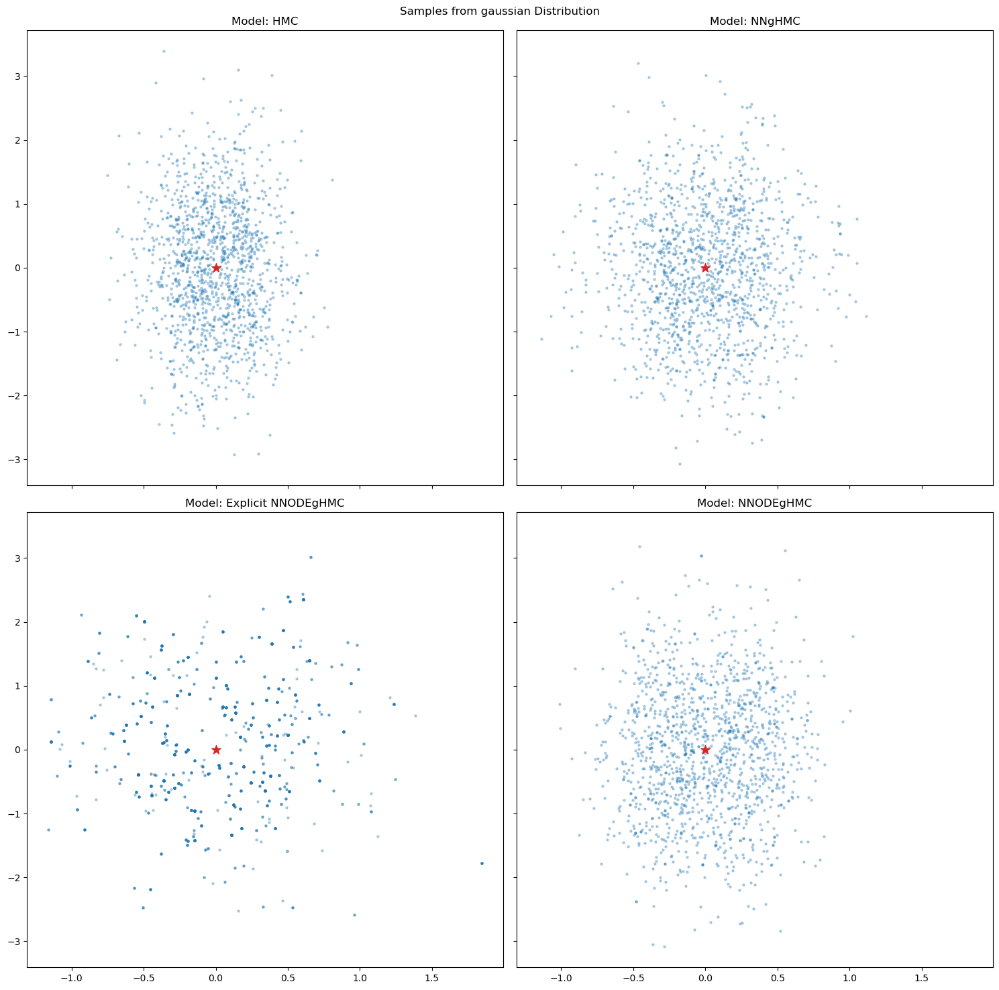

<Figure size 1500x1500 with 0 Axes>

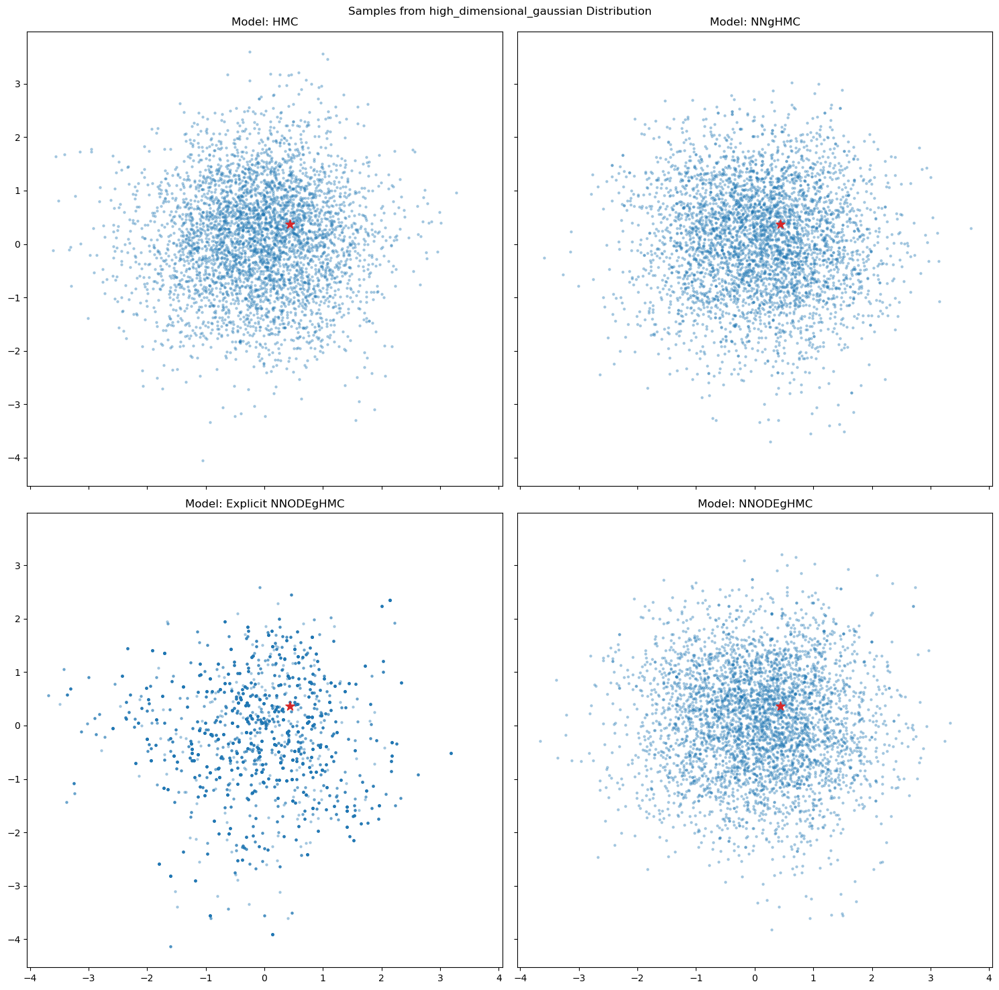

<Figure size 1500x1500 with 0 Axes>

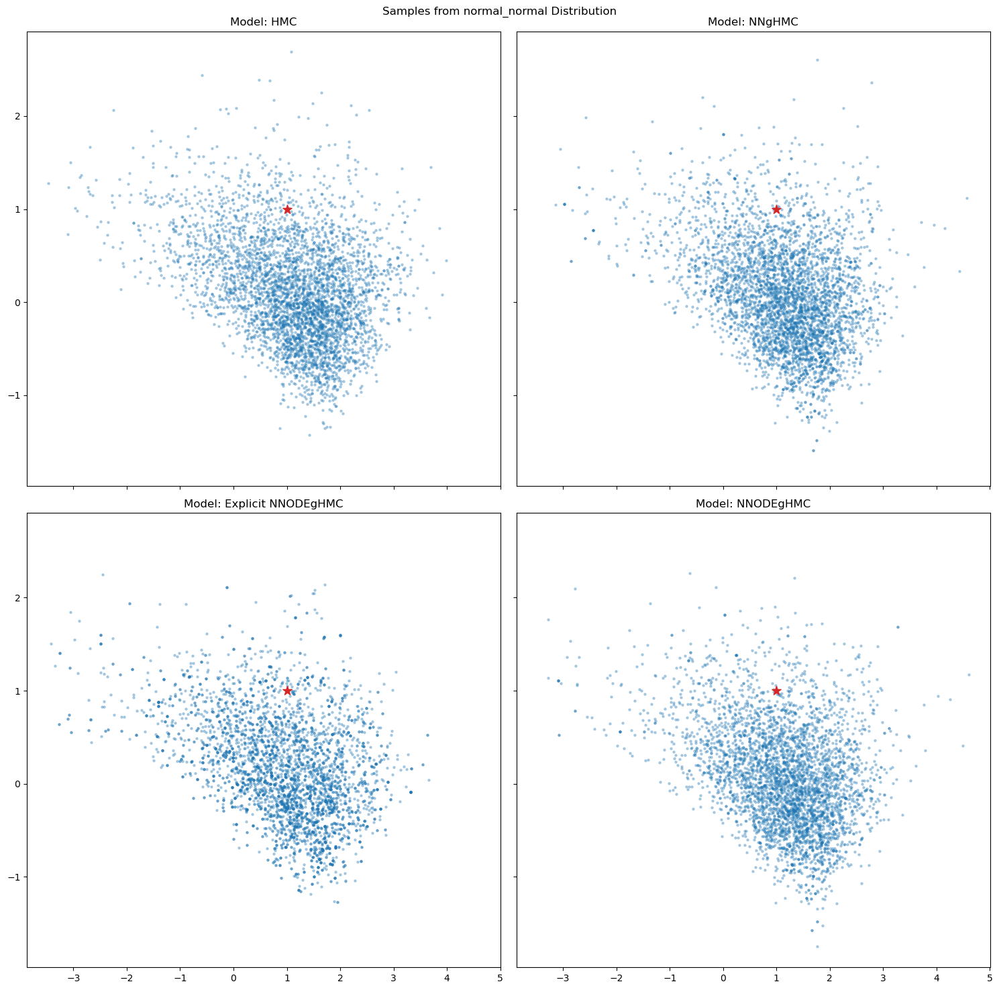

<Figure size 1500x1500 with 0 Axes>

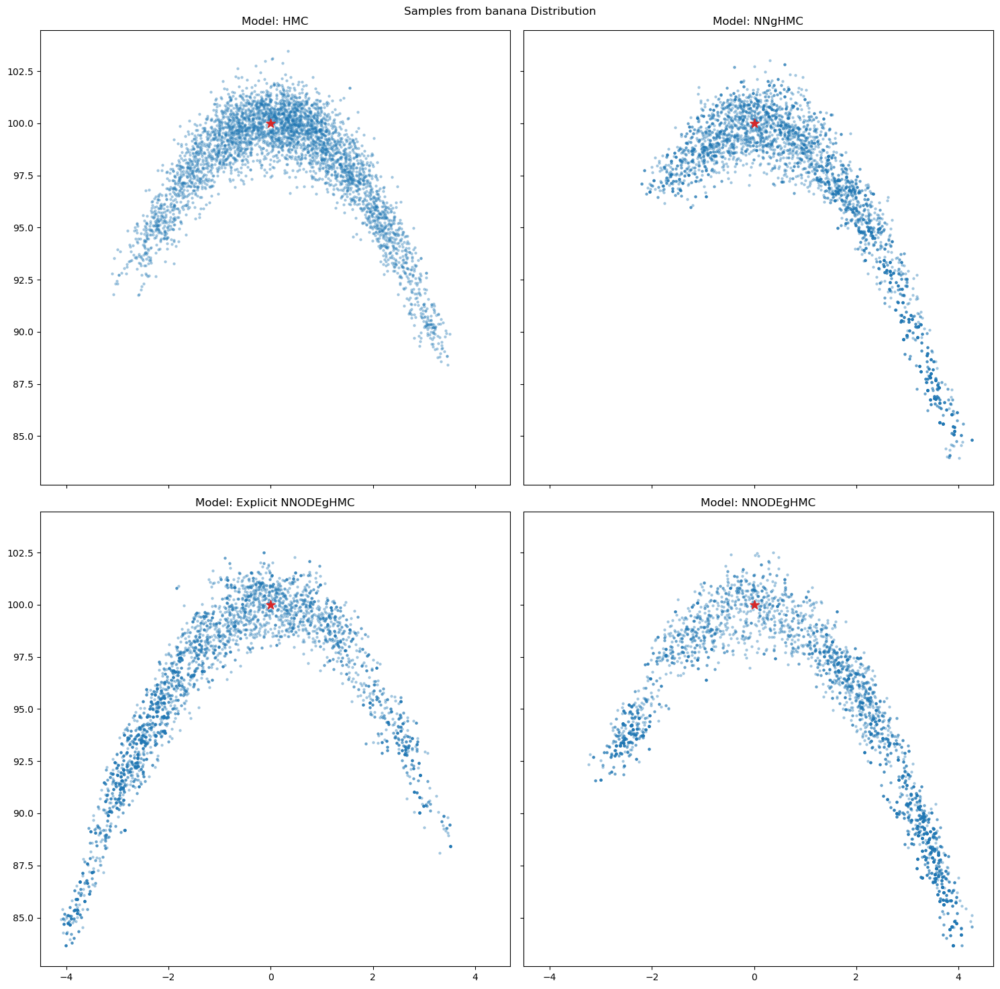

<Figure size 1500x1500 with 0 Axes>

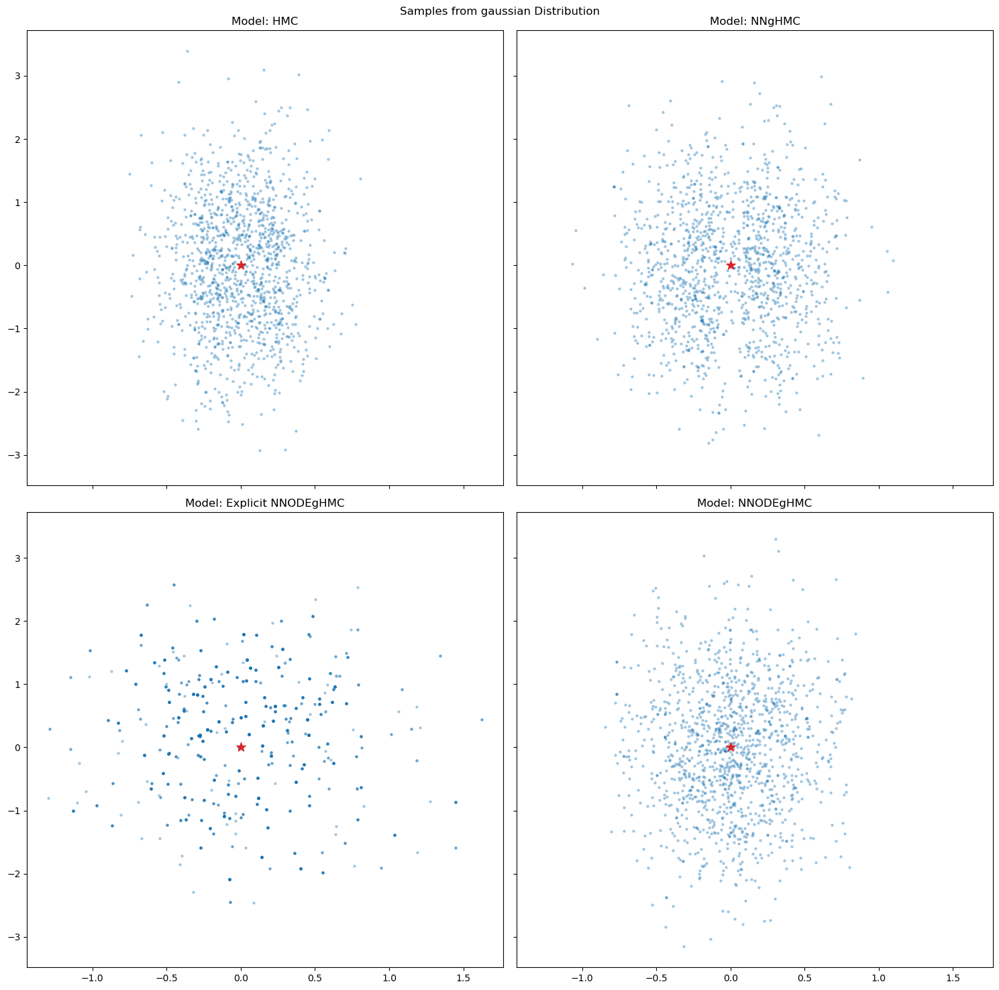

<Figure size 1500x1500 with 0 Axes>

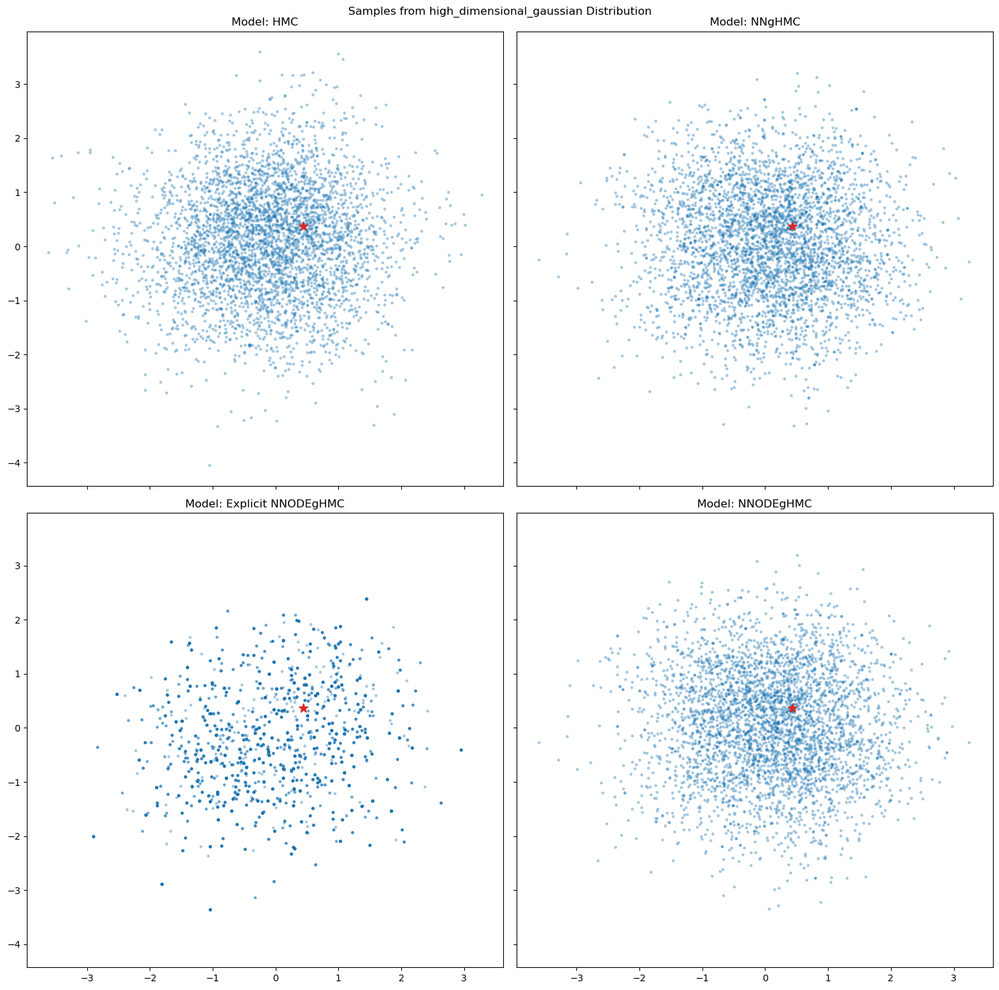

<Figure size 1500x1500 with 0 Axes>

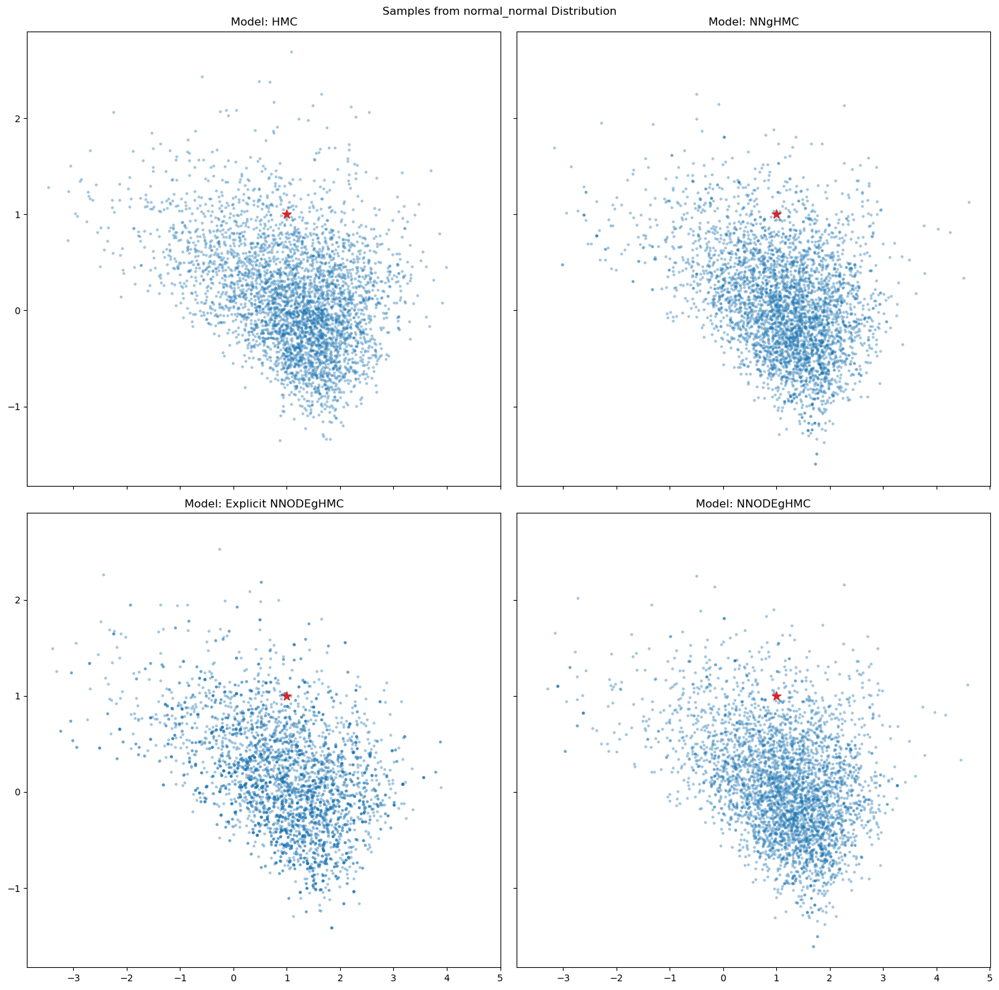

<Figure size 1500x1500 with 0 Axes>

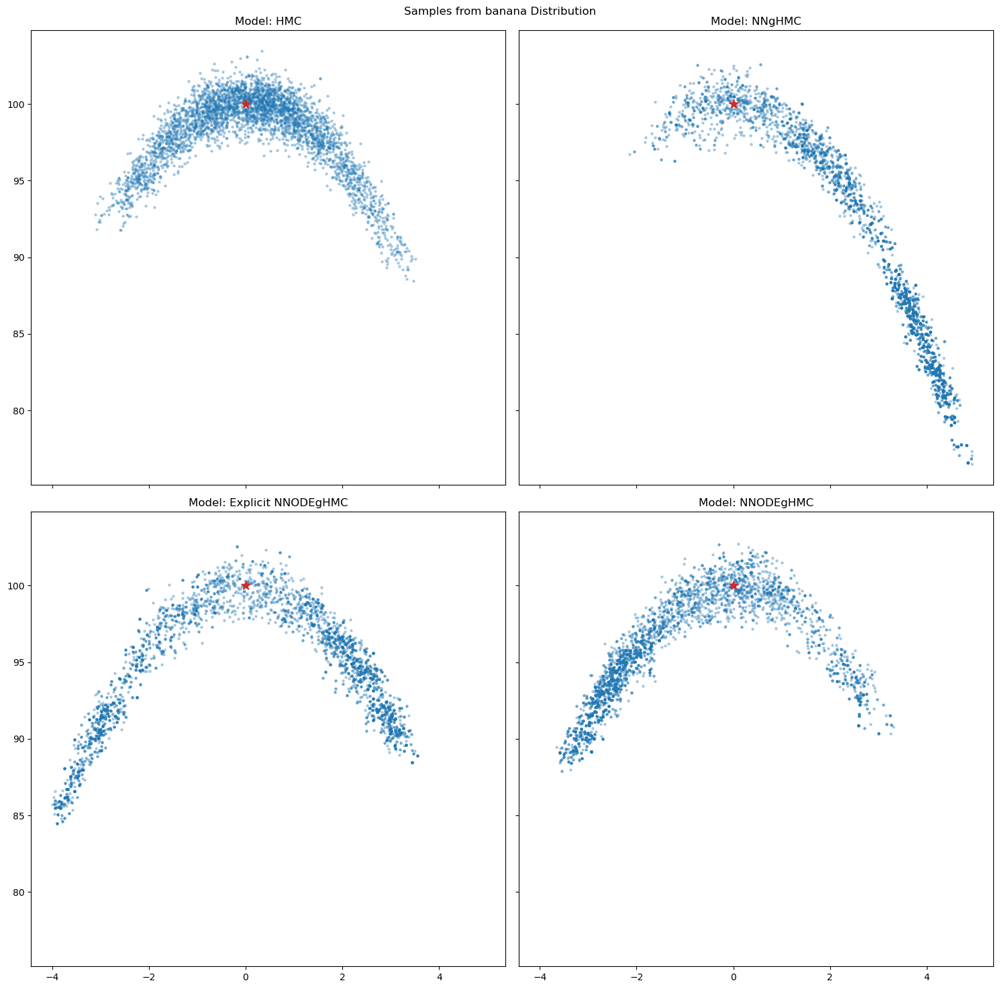

<Figure size 1500x1500 with 0 Axes>

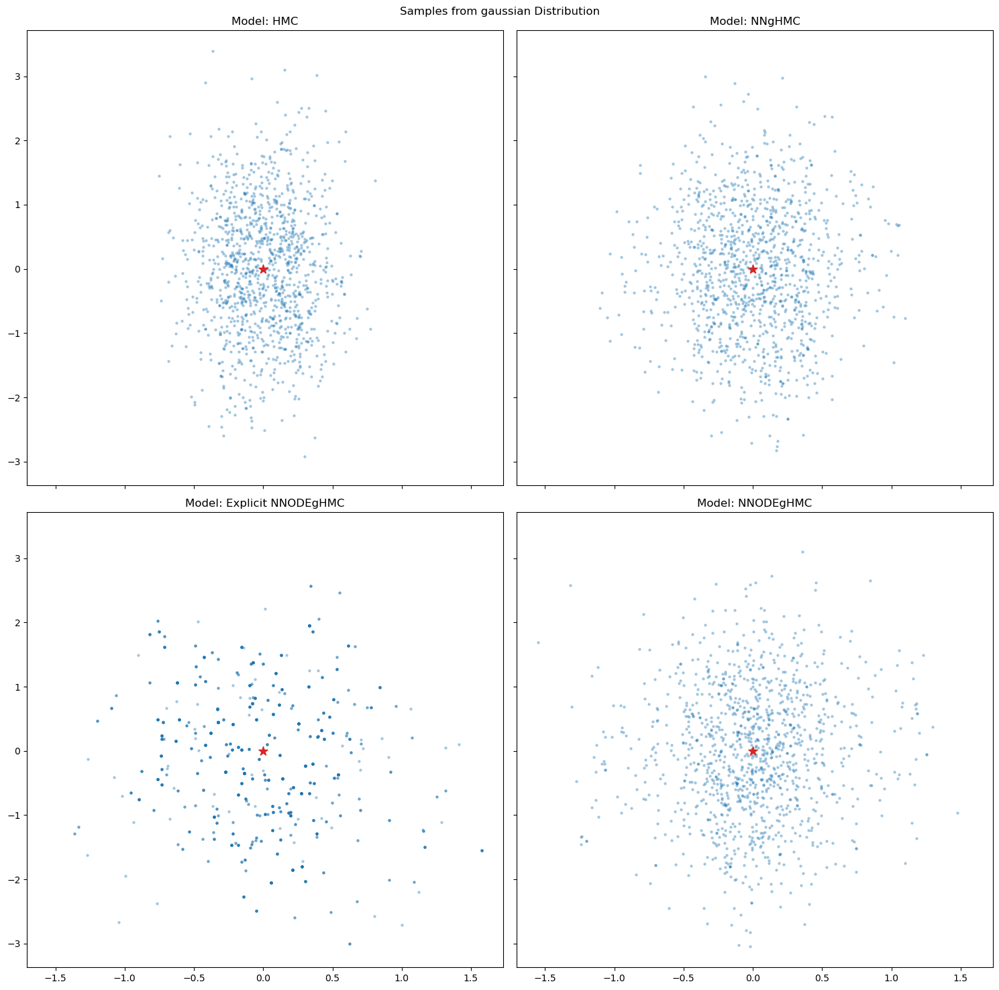

<Figure size 1500x1500 with 0 Axes>

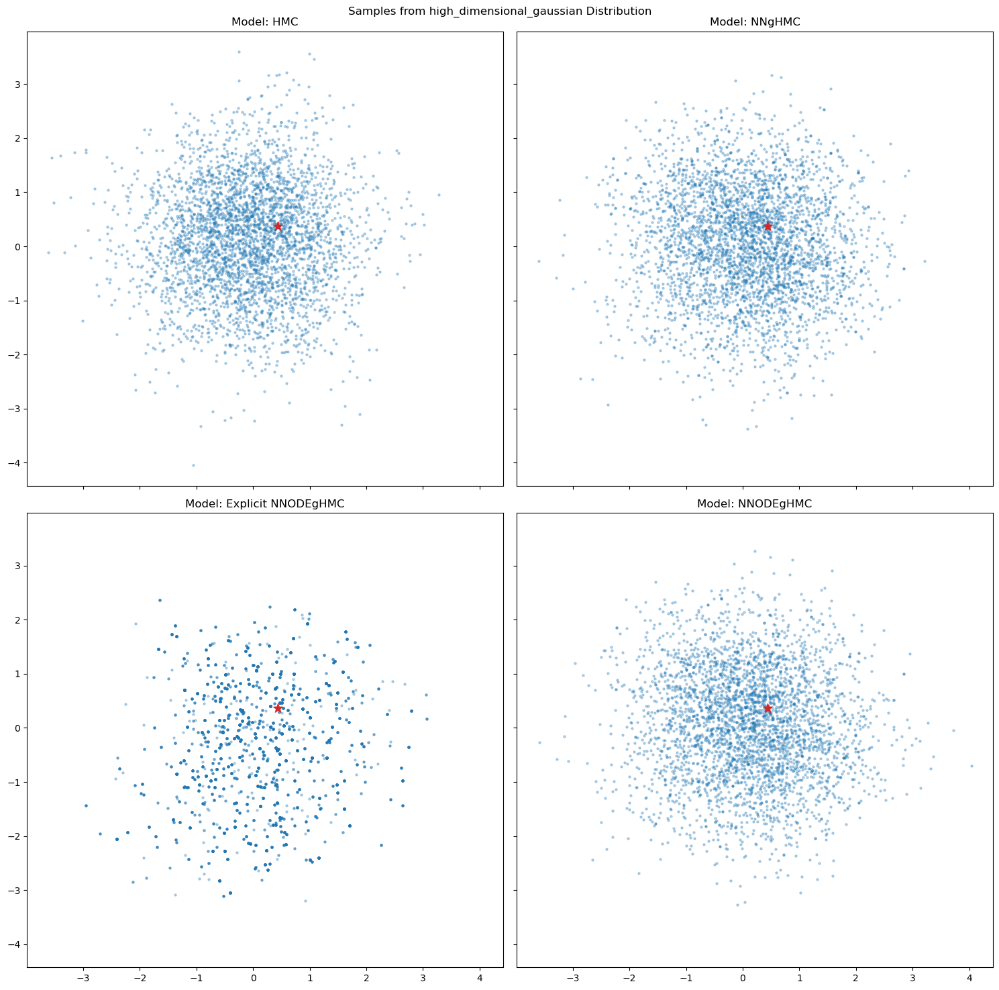

<Figure size 1500x1500 with 0 Axes>

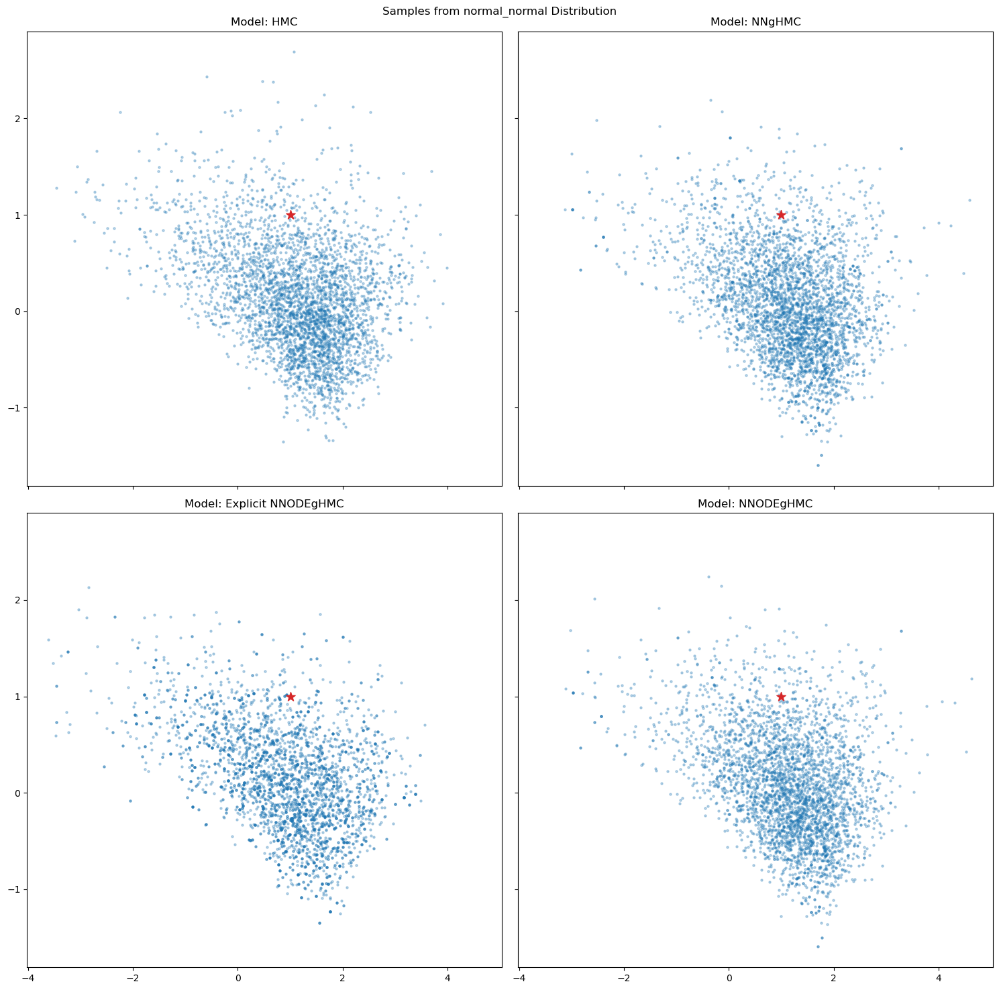

<Figure size 1500x1500 with 0 Axes>

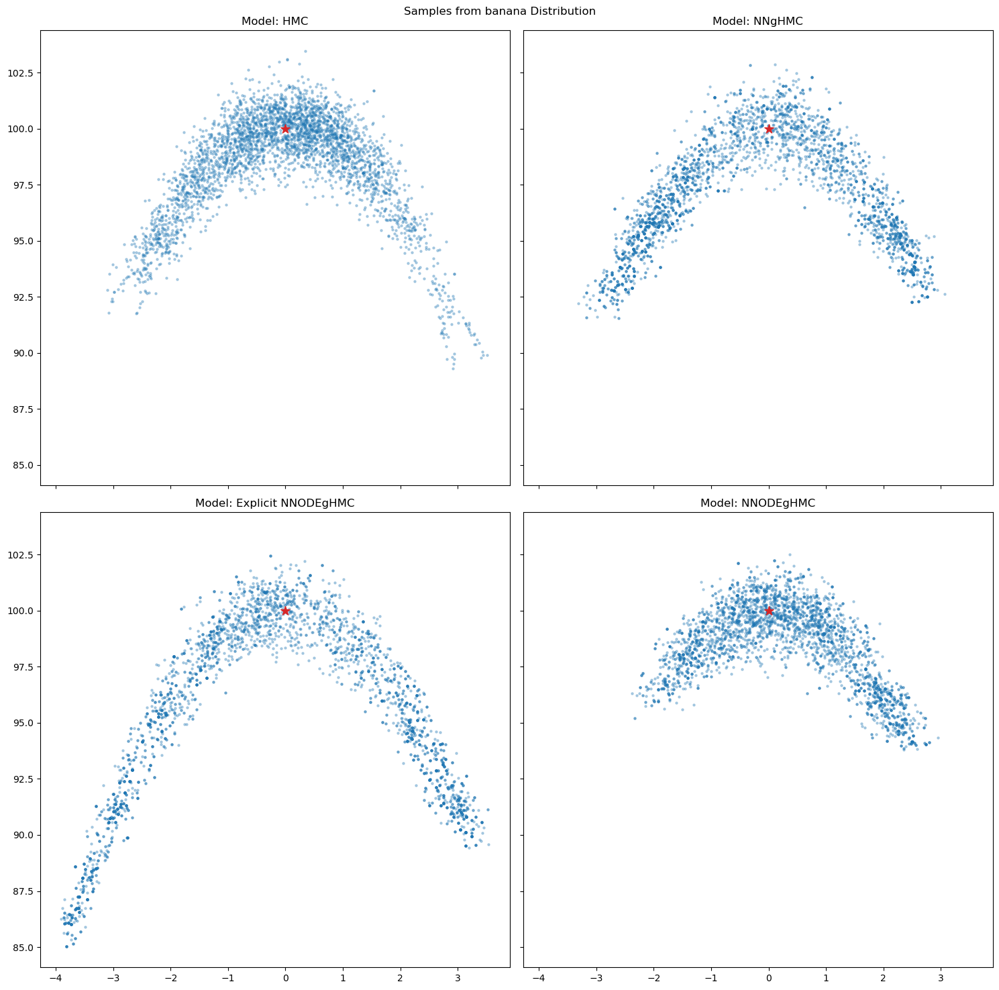

<Figure size 1500x1500 with 0 Axes>

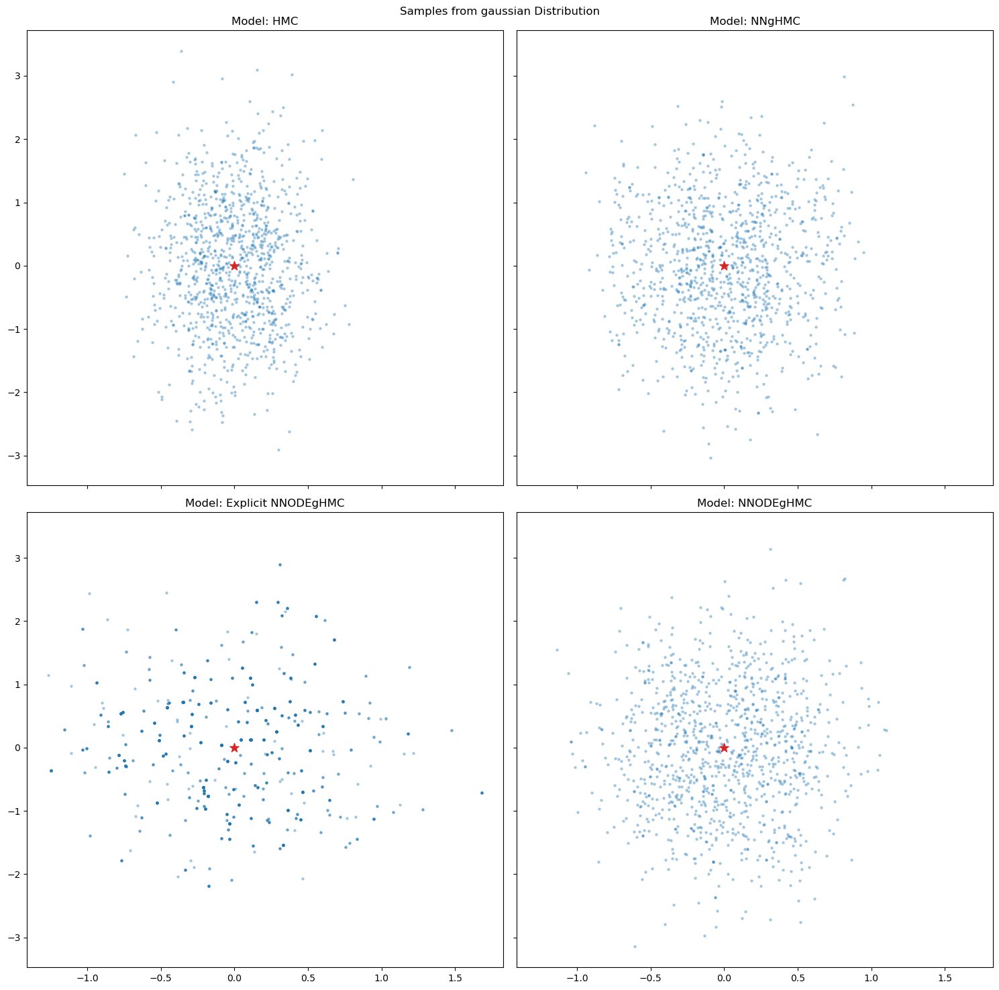

<Figure size 1500x1500 with 0 Axes>

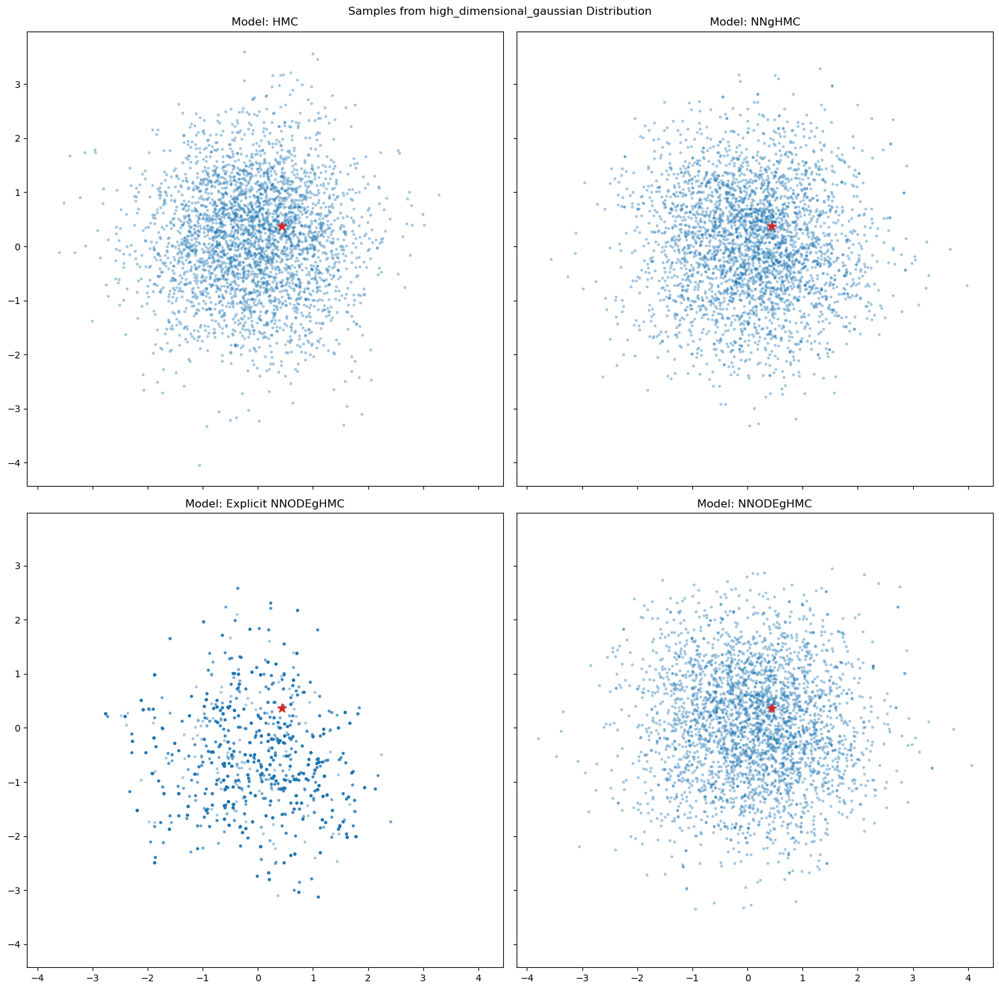

<Figure size 1500x1500 with 0 Axes>

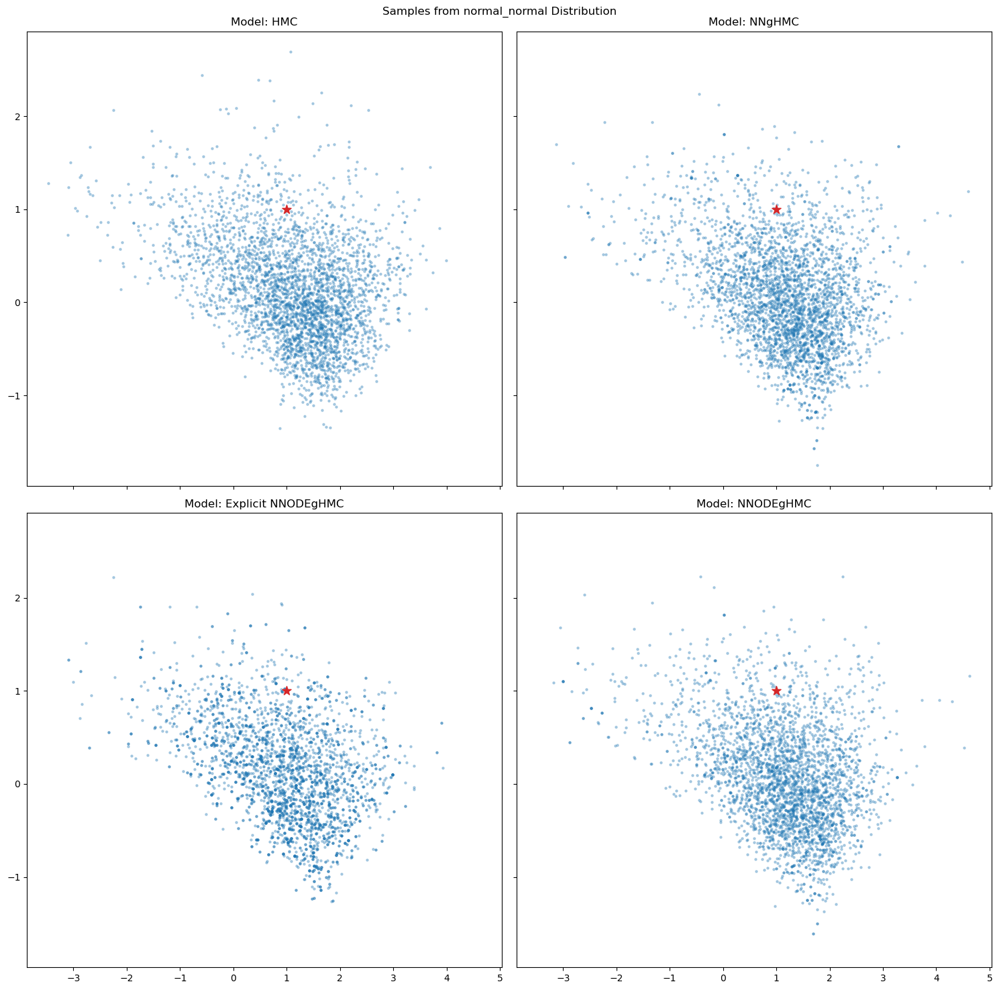

<Figure size 1500x1500 with 0 Axes>

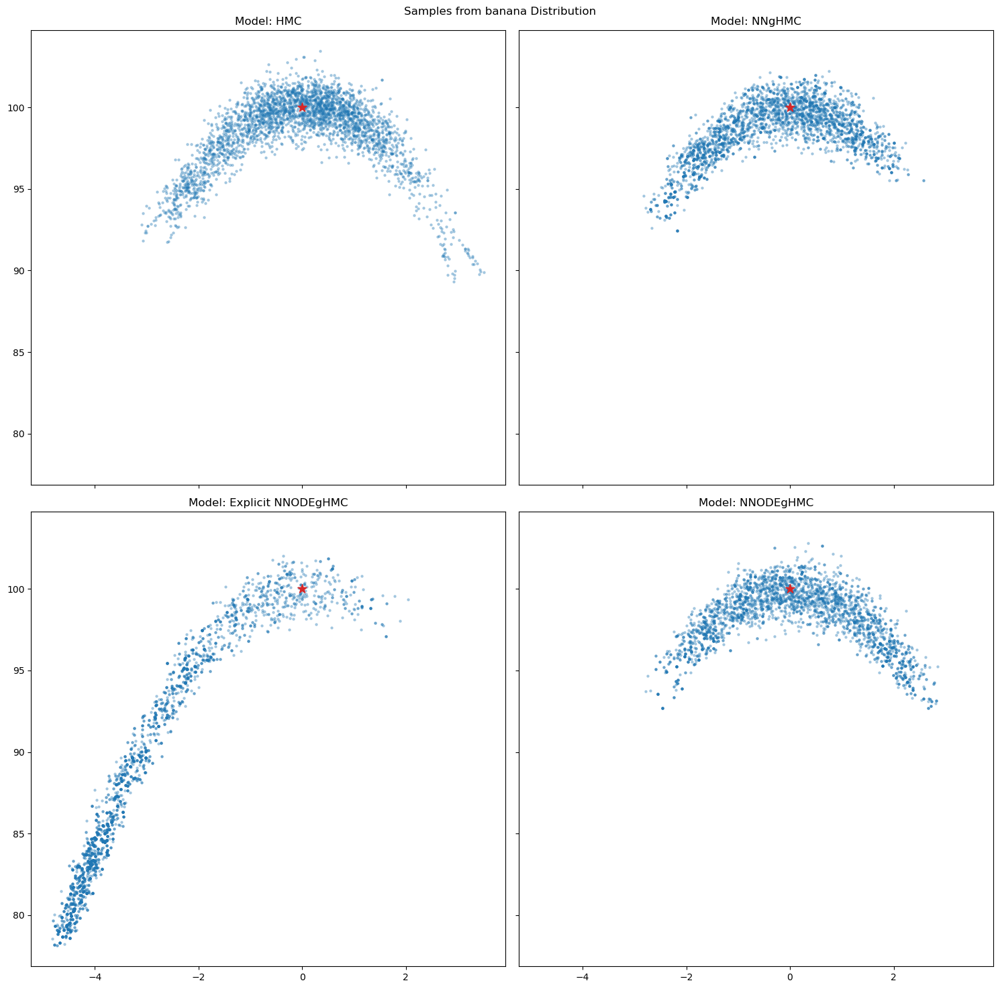

<Figure size 1500x1500 with 0 Axes>

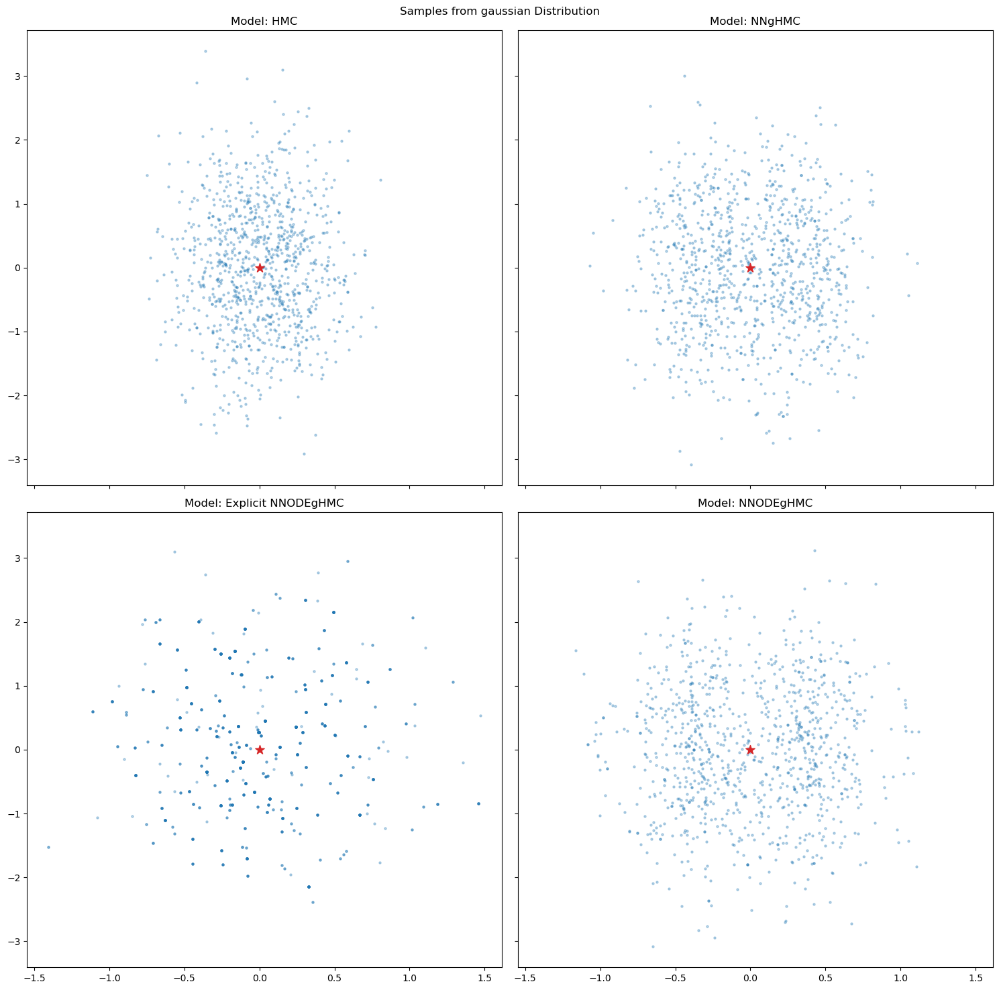

<Figure size 1500x1500 with 0 Axes>

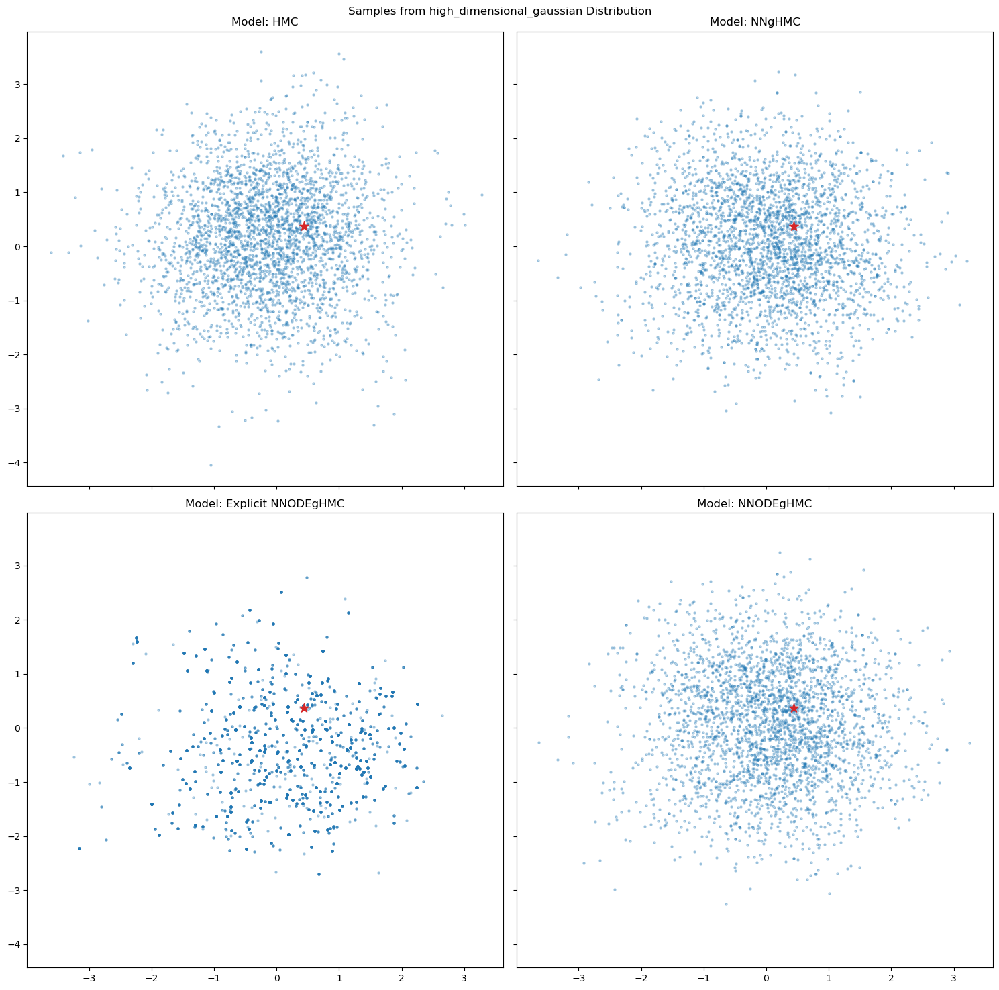

<Figure size 1500x1500 with 0 Axes>

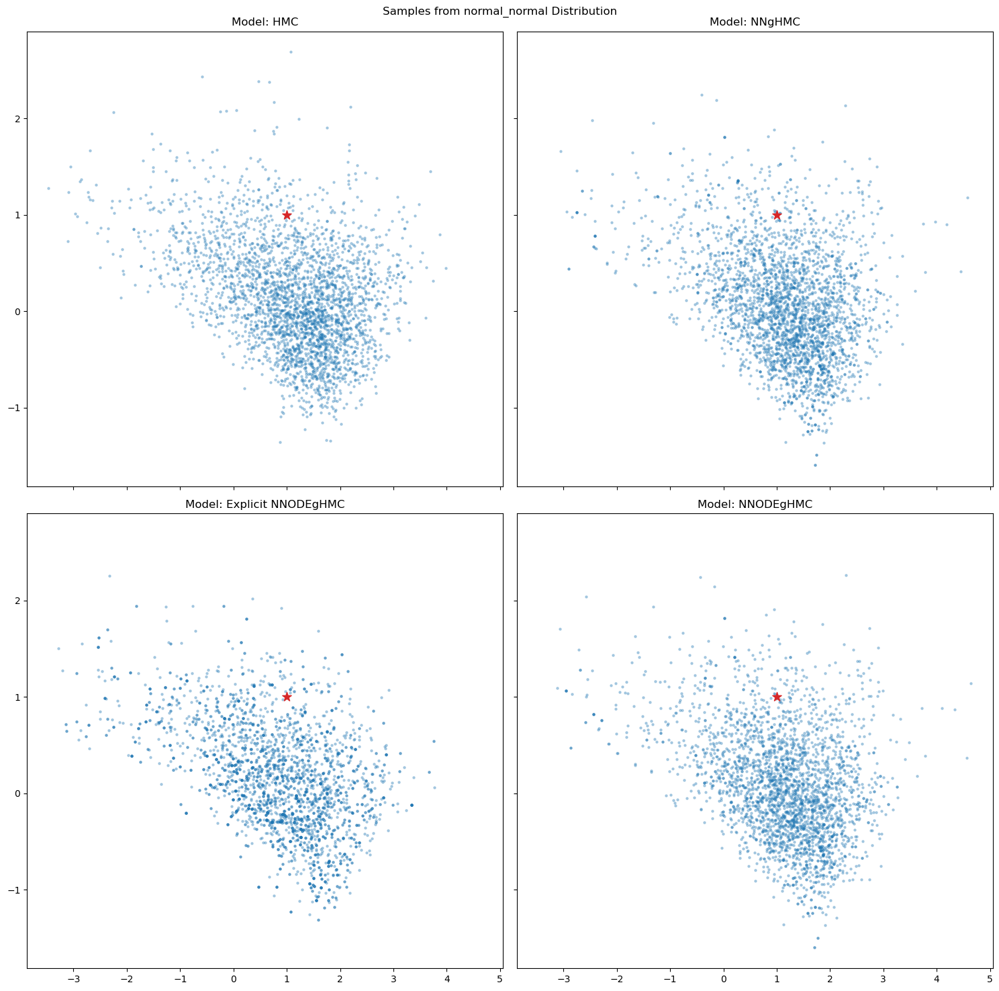

<Figure size 1500x1500 with 0 Axes>

In [2]:
hamiltorch.surrogate_neural_ode_hmc_sample_size_experiment()